In [743]:
import importlib
import time
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
from scipy import ndimage
from scipy import integrate
from scipy import interpolate

In [2]:
from multi_loc import covariance, assimilate, utilities

/home/travisharty/anaconda3/envs/loc/lib/python3.7/site-packages/sklearn/utils/__init__.py:4: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated, and in 3.8 it will stop working
  from collections import Sequence


In [3]:
%matplotlib inline

In [4]:
def imshow(X, title=None, vmin=None, vmax=None, cmap=None):
    plt.figure()
    im = plt.imshow(X, vmin=vmin, vmax=vmax, cmap=cmap)
    plt.colorbar(im)
    plt.title(title)

In [5]:
N_Z = 960
K = 32
I = 12
F = float(15)
b = float(10)
c = float(2.5)
alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)

coarse = 8
N_Xcoar = N_Z//coarse
K_coar = K//coarse

N_eZ = 20
N_eX = 500

# Long run to generate ensemble

In [369]:
# X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
# X_interp = np.concatenate([X_interp, [X_interp[0]]])
# x = np.arange(N_Z)
# x_interp = x[::K]
# x_interp = np.concatenate([x_interp, [x[-1] + 1]])
# f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
# X0 = f_X(x)
# Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)
# Z0 = X0 + X0*Y0/X0.max()
# t = np.linspace(0, 20, 100)
# Z = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# Z0 = Z[:, -1]
# T = 1000
# dt = 0.05
# N = int(T/dt + 1)
# t = np.linspace(0, T, N)
# Z = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# np.save('./Z_long_run.npy', Z)

Z = np.load('./Z_long_run.npy')

# Generate ensemble from long run

In [998]:
# X0_ens, Z0_ens = utilities.generate_X_Y_LM3_ens(Z, N_eX, N_eZ, coarse, I, alpha, beta)


# np.save('X0_ens', X0_ens)
# np.save('Z0_ens', Z0_ens)
X0_ens = np.load('X0_ens.npy')
Z0_ens = np.load('Z0_ens.npy')

In [999]:
P_X = np.cov(X0_ens)
P_Z = np.cov(Z0_ens)

In [1000]:
H_subgrid = np.eye(P_X.shape[0])
R_subgrid = 1 * np.eye(P_X.shape[0])
trans_mats = assimilate.transformation_matrices(
    H_subgrid, P=P_X,
    R=R_subgrid, return_Ts=True)

for key, val in trans_mats.items():
    key = key + '_X'
    print(key)
    exec(key + '=val')

P_sqrt_X
P_inv_sqrt_X
R_sqrt_X
R_inv_sqrt_X
U_X
S_X
VT_X
H_X
Tx_X
Tx_inv_X
Ty_X
Ty_inv_X


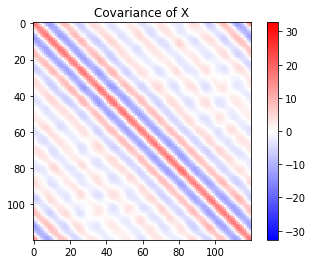

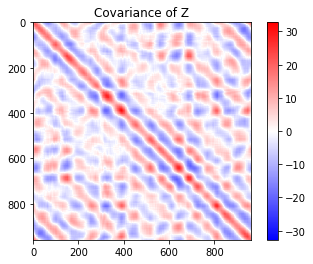

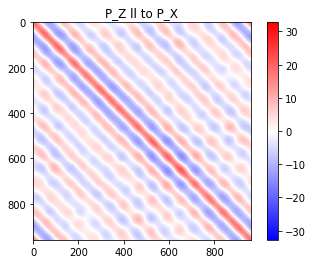

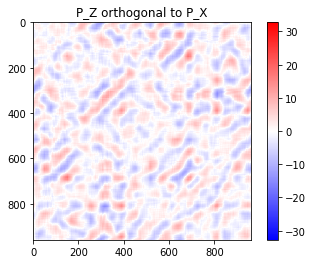

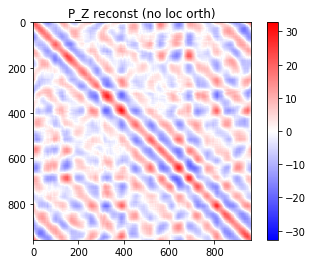

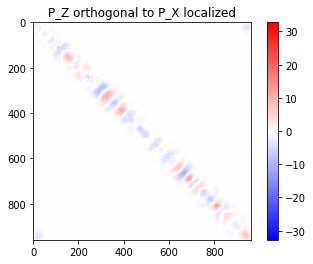

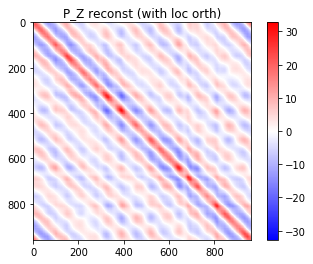

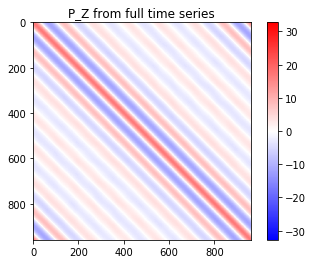

In [1001]:
VT_X_interp = utilities.upscale_on_loop(VT_X, coarse)

proj0 = VT_X_interp.T @ VT_X_interp

P_Z_ll_X = (VT_X_interp.T
        @ np.diag(np.diag(VT_X_interp @ P_Z @ VT_X_interp.T))
        @ VT_X_interp)
# P_Z_ll_X = proj0 @ P_Z @ proj0

proj = np.eye(N_Z) - proj0

D_inv_sqrt = np.diag(1/np.sqrt(np.diag(P_Z_ll_X)))

rho_Z_ll_X = D_inv_sqrt @ P_Z_ll_X @ D_inv_sqrt

P_Z_orth_X = P_Z - P_Z_ll_X

# P_Z_orth_X_loc = rho_Z_ll_X * P_Z_orth_X
P_Z_orth_X_loc = rho * P_Z_orth_X

P_Z_reconst = P_Z_ll_X + P_Z_orth_X

# P_Z_reconst_loc = P_Z_ll_X + P_Z_orth_X_loc
D_sqrt_Z = np.diag(np.sqrt(np.diag(P_Z)))
P_Z_reconst_loc = D_sqrt_Z @ rho_Z_ll_X @ D_sqrt_Z

P_Z_GT = np.cov(Z)

vmax = np.max(
    [np.abs(P_Z).max(),
     np.abs(P_Z_ll_X).max(),
     np.abs(P_Z_orth_X).max(),
     np.abs(P_Z_reconst).max(),
     np.abs(P_Z_reconst_loc).max(), 
     np.abs(P_Z_GT).max()])
vmax_X = np.abs(P_X).max()

imshow(P_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of X')
imshow(P_Z, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of Z')
imshow(P_Z_ll_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z ll to P_X')
# imshow(diff, vmax=vmax, vmin=-vmax, cmap='bwr',
#        title='P_X - P_Z_ll')
imshow(P_Z_orth_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z orthogonal to P_X')
imshow(P_Z_reconst, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z reconst (no loc orth)')
imshow(P_Z_orth_X_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z orthogonal to P_X localized')
imshow(P_Z_reconst_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z reconst (with loc orth)')
imshow(P_Z_GT, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z from full time series')

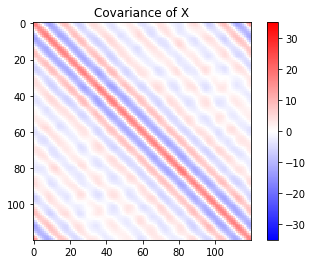

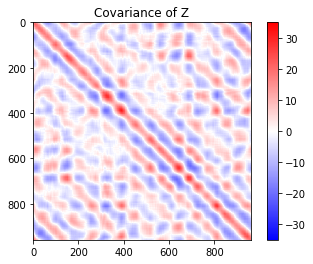

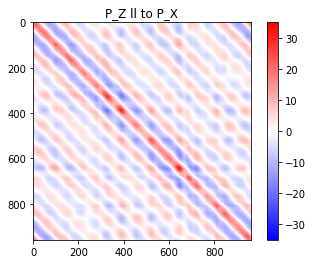

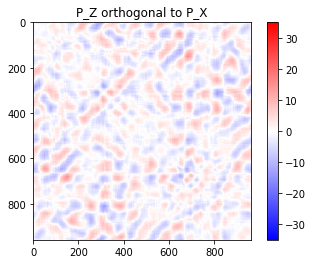

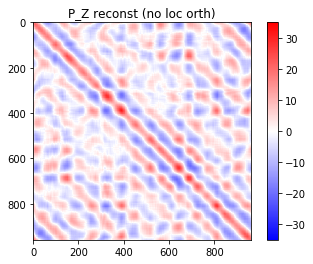

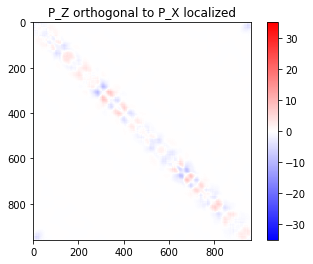

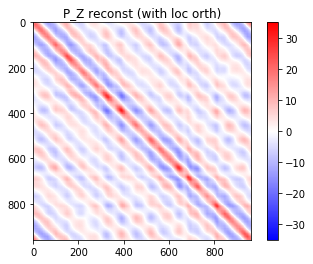

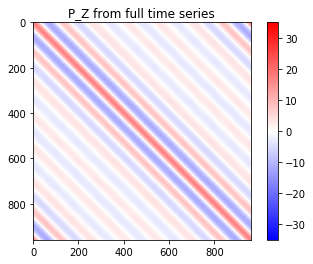

In [1002]:
d_Z = np.diag(P_Z)
D_Z_sqrt = np.diag(np.sqrt(d_Z))
D_Z_inv_sqrt = np.diag(1/np.sqrt(d_Z))
C_Z = D_Z_inv_sqrt @ P_Z @ D_Z_inv_sqrt

VT_X_interp = utilities.upscale_on_loop(VT_X, coarse)

proj0 = VT_X_interp.T @ VT_X_interp

P_Z_ll_X = (VT_X_interp.T
        @ np.diag(np.diag(VT_X_interp @ C_Z @ VT_X_interp.T))
        @ VT_X_interp)
# P_Z_ll_X = proj0 @ P_Z @ proj0

P_Z_ll_X = D_Z_sqrt @ P_Z_ll_X @ D_Z_sqrt

proj = np.eye(N_Z) - proj0

D_inv_sqrt = np.diag(1/np.sqrt(np.diag(P_Z_ll_X)))

rho_Z_ll_X = D_inv_sqrt @ P_Z_ll_X @ D_inv_sqrt

P_Z_orth_X = P_Z - P_Z_ll_X

# P_Z_orth_X_loc = rho_Z_ll_X * P_Z_orth_X
P_Z_orth_X_loc = rho * P_Z_orth_X

P_Z_reconst = P_Z_ll_X + P_Z_orth_X

# P_Z_reconst_loc = P_Z_ll_X + P_Z_orth_X_loc
D_sqrt_Z = np.diag(np.sqrt(np.diag(P_Z)))
P_Z_reconst_loc = D_sqrt_Z @ rho_Z_ll_X @ D_sqrt_Z

P_Z_GT = np.cov(Z)

vmax = np.max(
    [np.abs(P_Z).max(),
     np.abs(P_Z_ll_X).max(),
     np.abs(P_Z_orth_X).max(),
     np.abs(P_Z_reconst).max(),
     np.abs(P_Z_reconst_loc).max(), 
     np.abs(P_Z_GT).max()])
vmax_X = np.abs(P_X).max()

imshow(P_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of X')
imshow(P_Z, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of Z')
imshow(P_Z_ll_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z ll to P_X')
# imshow(diff, vmax=vmax, vmin=-vmax, cmap='bwr',
#        title='P_X - P_Z_ll')
imshow(P_Z_orth_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z orthogonal to P_X')
imshow(P_Z_reconst, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z reconst (no loc orth)')
imshow(P_Z_orth_X_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z orthogonal to P_X localized')
imshow(P_Z_reconst_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z reconst (with loc orth)')
imshow(P_Z_GT, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z from full time series')

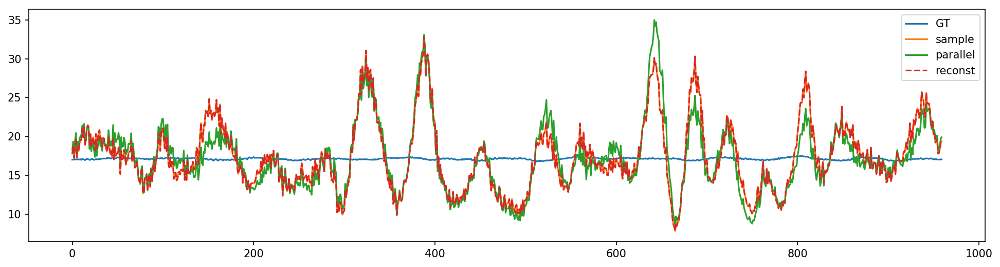

In [1003]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(np.diag(P_Z_GT))
plt.plot(np.diag(P_Z))
plt.plot(np.diag(P_Z_ll_X))
plt.plot(np.diag(P_Z_reconst_loc), '--')
plt.legend(['GT', 'sample', 'parallel', 'reconst'])

In [1004]:
# aH_subgrid = np.eye(P_Z.shape[0])
# aR_subgrid = 1 * np.eye(P_Z.shape[0])
# trans_mats = assimilate.transformation_matrices(
#     aH_subgrid, P=P_Z_orth_X_loc,
#     R=aR_subgrid, return_Ts=True)

# for key, val in trans_mats.items():
#     key = key + '_Z_orth'
#     print(key)
#     exec(key + '=val')

In [1005]:
# u, s, vt = np.linalg.svd(P_Z_orth_X_loc)
# imshow(vt.T @ np.diag(s) @ vt, vmax=vmax, vmin=-vmax, cmap='bwr')
# imshow(P_Z_orth_X_loc, vmax=vmax, vmin=-vmax, cmap='bwr')

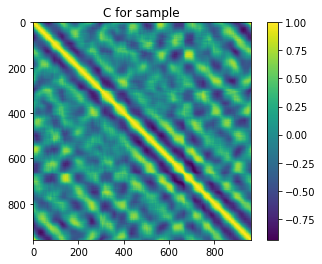

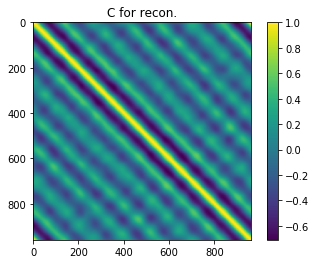

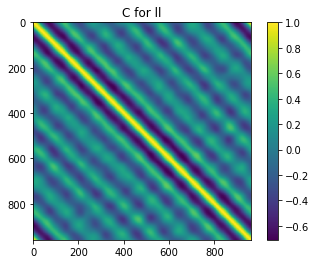

In [1006]:
D_sqrt_inv = np.diag(1/np.sqrt(np.diag(P_Z)))
C_Z = D_sqrt_inv @ P_Z @ D_sqrt_inv
imshow(C_Z, title='C for sample')

D_sqrt_inv = np.diag(1/np.sqrt(np.diag(P_Z_reconst_loc)))
C_Z_loc = D_sqrt_inv @ P_Z_reconst_loc @ D_sqrt_inv
imshow(C_Z_loc, title='C for recon.')

D_sqrt_inv = np.diag(1/np.sqrt(np.diag(P_Z_ll_X)))
C_Z_ll = D_sqrt_inv @ P_Z_ll_X @ D_sqrt_inv
imshow(C_Z_ll, title='C for ll')

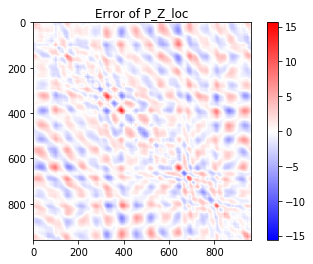

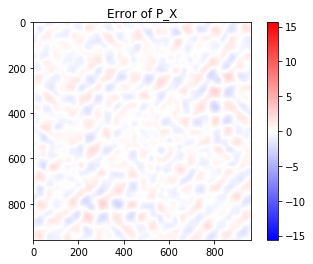

In [1007]:
P_X_interp = VT_X_interp.T @ S_X**2 @ VT_X_interp * coarse

error_P_Z_loc = P_Z_reconst_loc - P_Z_GT
error_P_X = P_X_interp - P_Z_GT
vmax = np.max(
    [np.abs(error_P_Z_loc),
     np.abs(error_P_X)])
imshow(error_P_Z_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Error of P_Z_loc')
imshow(error_P_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Error of P_X')

In [380]:
# X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
# X_interp = np.concatenate([X_interp, [X_interp[0]]])
# x = np.arange(N_Z)
# x_interp = x[::K]
# x_interp = np.concatenate([x_interp, [x[-1] + 1]])
# f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
# X0 = f_X(x)
# Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)
# Z0 = X0 + X0*Y0/X0.max()
# t = np.linspace(0, 20, 100)
# Z_temp = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# Z0 = Z_temp[:, -1]
# T = 1000
# dt = 0.05
# N = int(T/dt + 1)
# t = np.linspace(0, T, N)
# Z_GT = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# np.save('./Z_GT.npy', Z_GT)

Z_GT = np.load('./Z_GT.npy')

In [381]:
X_GT = np.load('./X_GT.npy')
Y_GT = np.load('./Y_GT.npy')

# Assimilate first obs

In [1008]:
co_spacing = 8
den_patches = 18
# patch_size = 15
patch_size = 30

Zc_obs_loc = np.arange(N_Z)[::co_spacing]

dense_patch = np.arange(-patch_size//2, patch_size//2 + 1)
dense_patch_loc = np.random.choice(N_Z, size=dense_patches, replace=False)
Zd_obs_loc = dense_patch_loc[:, None] + dense_patch[None, :]
Zd_obs_loc = Zd_obs_loc.ravel() % N_Z
Zd_obs_loc = np.unique(Zd_obs_loc)
Zd_obs_loc.sort()

N_co = Zc_obs_loc.size
N_do = Zd_obs_loc.size
print('Coarse obs size: ', N_co)
print('Dense obs size: ', N_do)

Coarse obs size:  120
Dense obs size:  428


R and H for Z

In [1009]:
R_Zc_sd = 2 * np.ones(N_co)
R_Zd_sd = .2 * np.ones(N_do)
R_Z = np.diag(np.concatenate([R_Zc_sd**2, R_Zd_sd**2]))

H_coar = np.eye(N_Z)[Zc_obs_loc]
H_dense = np.eye(N_Z)[Zd_obs_loc]
H_Z = np.concatenate([H_coar, H_dense], axis=0)

R and H for X

In [1010]:
R_Xc_sd = 2
R_Xc = (R_Xc_sd**2) * np.eye(N_Z//coarse)
H_Xc = np.eye(N_Z)[::coarse]

In [1011]:
Z_obs = np.random.multivariate_normal(H_Z @ Z_GT[:, 0], R_Z)
x_full = np.arange(N_Z)
zx_obs = H_Z @ x_full

X_obs = np.random.multivariate_normal(H_Xc @ X_GT[:, 0], R_Xc)
xx_obs = H_Xc @ x_full

In [1012]:
# Z_interp = utilities.interp_on_loop(Z=Z_obs, x=x_obs, x_interp=x_full)
# X_interp = utilities.window_sum_Z(Z_interp, I=I, alpha=alpha, beta=beta)
# X_obs = X_interp[::coarse]

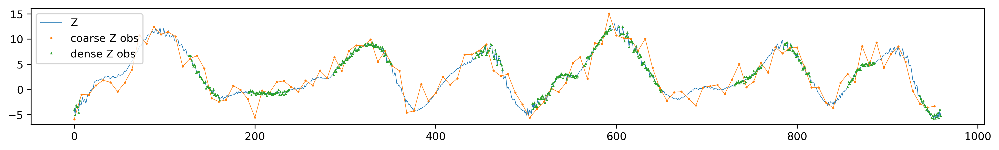

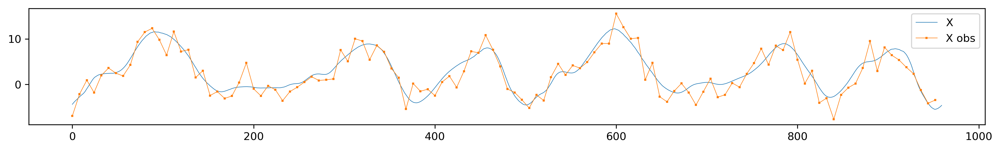

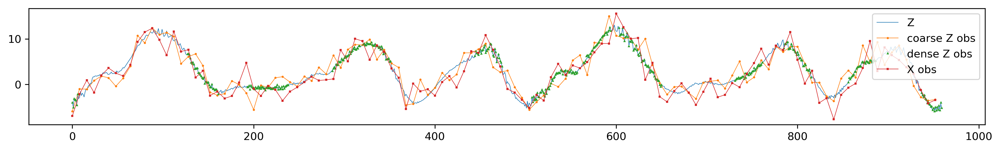

In [1013]:
figsize = plt.figaspect(1/8)
plt.figure(dpi=300, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=0.5)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs'])

figsize = plt.figaspect(1/8)
plt.figure(dpi=300, figsize=figsize)
plt.plot(X_GT[:, 0], linewidth=0.5)
plt.plot(xx_obs, X_obs, '-s', markersize=1, linewidth=0.5)
plt.legend(['X', 'X obs'])

figsize = plt.figaspect(1/8)
plt.figure(dpi=300, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=0.5)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(xx_obs, X_obs, '-s', markersize=1, linewidth=0.5)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'X obs'])

# Use SVD localization

In [1014]:
atitle = 'SVD loc'

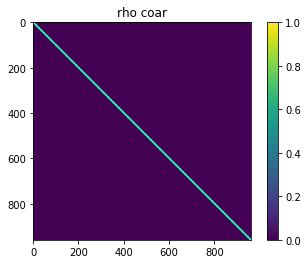

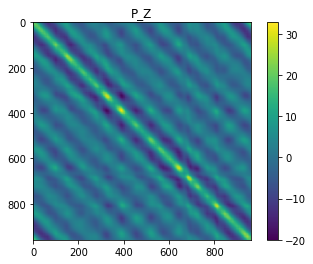

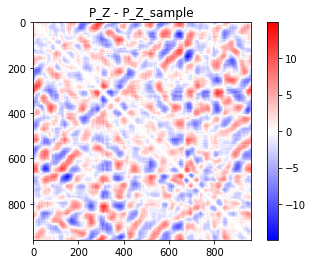

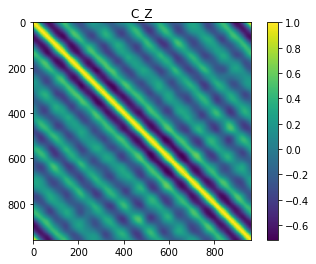

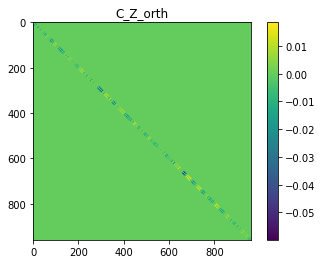

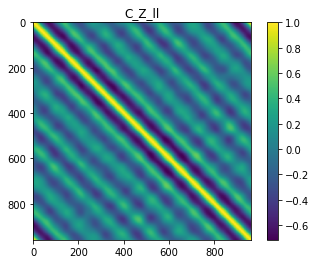

In [1020]:
importlib.reload(assimilate)

[rho_coar] = covariance.generate_circulant(N_Z, 1, 4, covariance.fft_sqd_exp_1d,
                                             return_Corr=True, return_eig=False)
imshow(rho_coar, 'rho coar')

X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse, rho_coar=rho_coar)

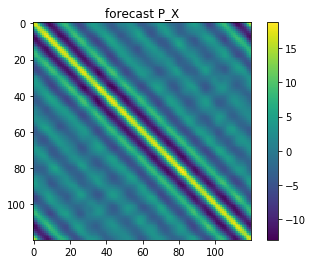

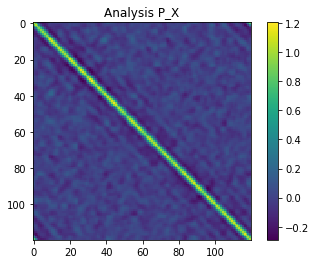

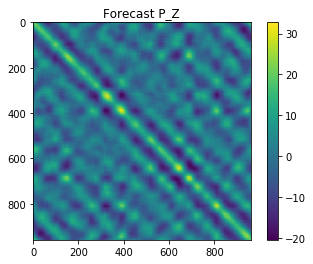

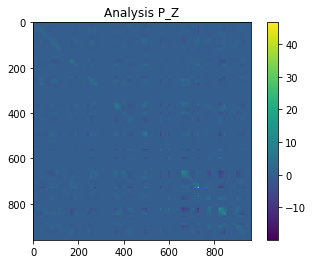

In [1021]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, 'forecast P_X')
imshow(P_X_a, 'Analysis P_X')
imshow(P_Z_f, 'Forecast P_Z')
imshow(P_Z_a, 'Analysis P_Z')

Text(0.5,1,'SVD loc')

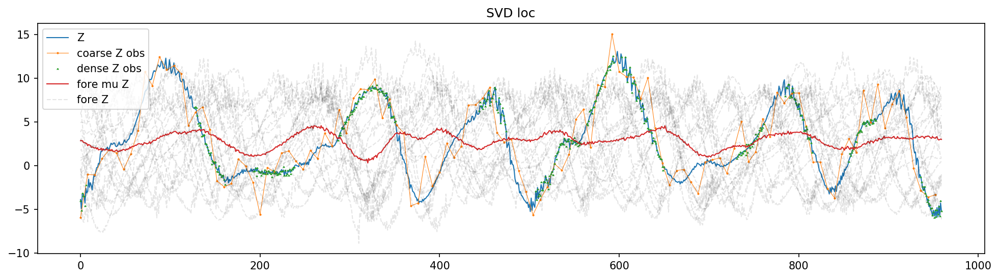

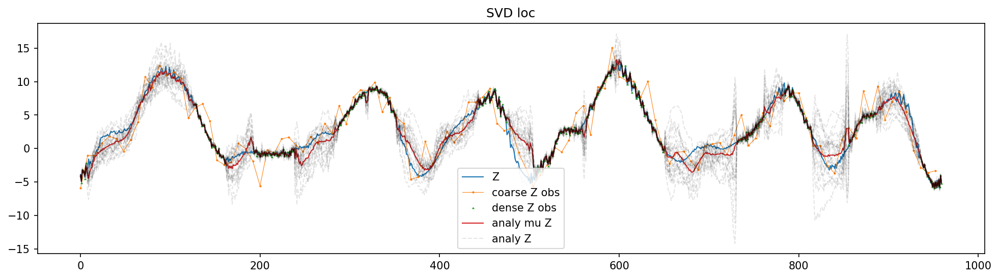

In [1022]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])
plt.title(atitle)

Text(0.5,1,'Y analysis with SVD loc; rmse: 0.353')

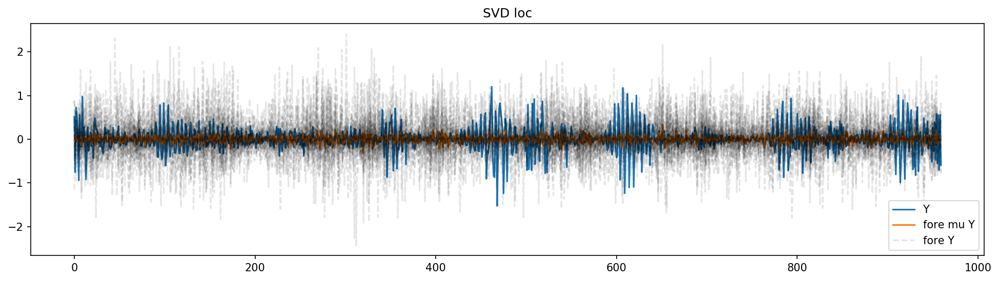

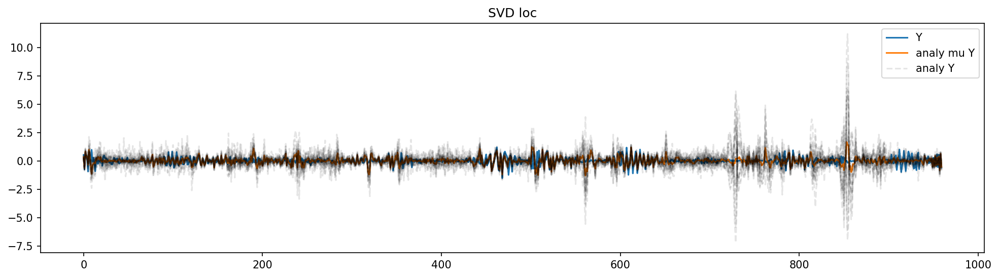

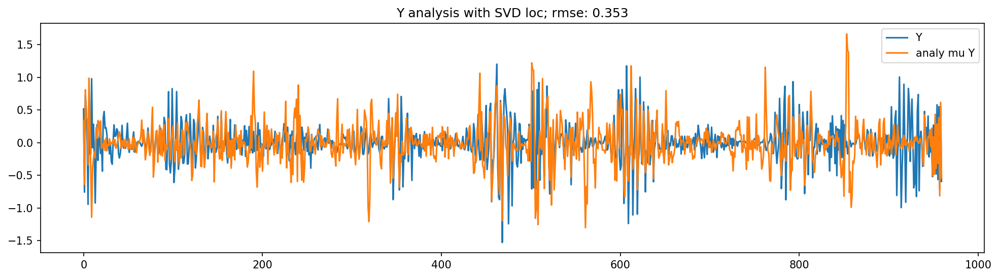

In [1023]:
this_X_ens_f = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
this_Y_ens_f = Z0_ens - this_X_ens_f

this_X_ens_a = utilities.window_sum_Z(Z_ens_a, I=I, alpha=alpha, beta=beta)
this_Y_ens_a = Z_ens_a - this_X_ens_a


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_f, axis=-1))
plt.plot(this_Y_ens_f, 'k--', alpha=.1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.plot(this_Y_ens_a, 'k--', alpha=.1)
plt.legend(['Y', 'analy mu Y', 'analy Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.legend(['Y', 'analy mu Y'])

mu = np.mean(this_Y_ens_a, axis=-1)
rmse = np.sqrt(((mu - Y_GT[:, 0])**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with SVD loc; rmse: 46.81')

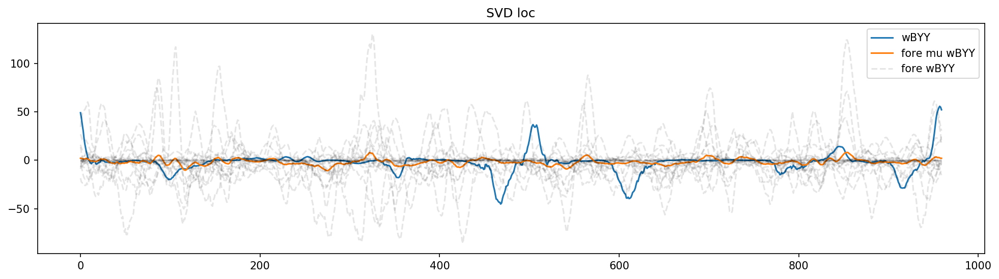

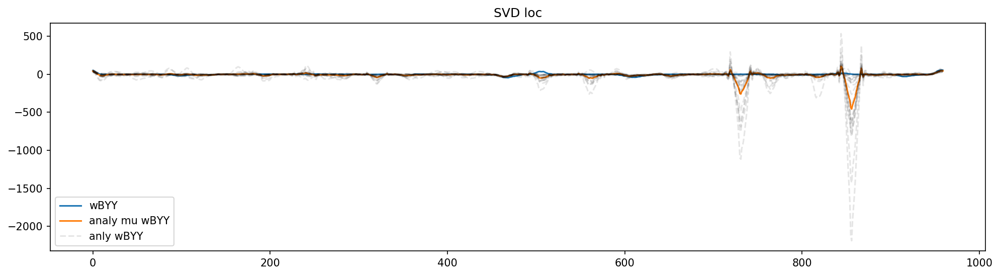

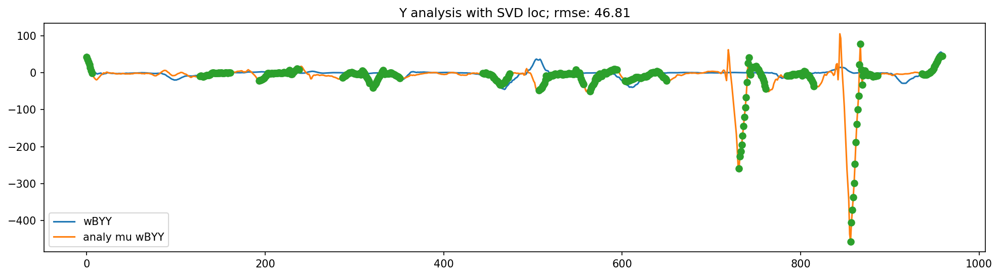

In [1024]:
BYY_GT = b**2 * utilities.bracket([Y_GT[:, 0]], 1)
wBYY_GT = utilities.window_sum_Z(BYY_GT, I=I, alpha=alpha, beta=beta)

BYY_ens_f = b**2 * utilities.bracket([this_Y_ens_f], 1)
wBYY_ens_f = utilities.window_sum_Z(BYY_ens_f, I=I, alpha=alpha, beta=beta)

BYY_ens_a = b**2 * utilities.bracket([this_Y_ens_a], 1)
wBYY_ens_a = utilities.window_sum_Z(BYY_ens_a, I=I, alpha=alpha, beta=beta)

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_f, axis=-1))
plt.plot(wBYY_ens_f, 'k--', alpha=.1)
plt.legend(['wBYY', 'fore mu wBYY', 'fore wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(wBYY_ens_a, 'k--', alpha=.1)
plt.legend(['wBYY', 'analy mu wBYY', 'anly wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(Zd_obs_loc, np.mean(wBYY_ens_a, axis=-1)[Zd_obs_loc], 'o')
plt.legend(['wBYY', 'analy mu wBYY'])

mu = np.mean(wBYY_ens_a, axis=-1)
rmse = np.sqrt(((mu - wBYY_GT)**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'SVD loc')

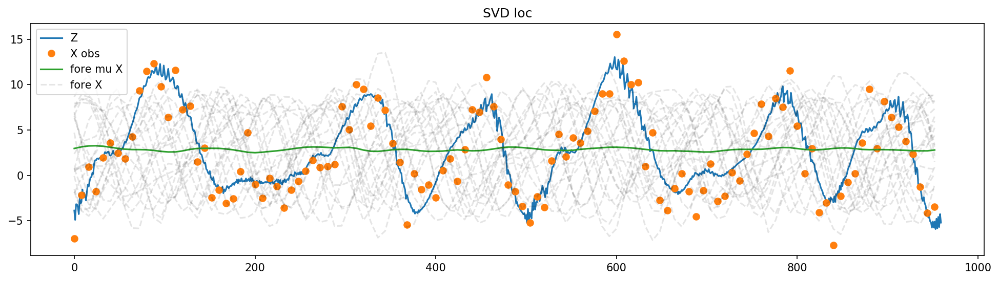

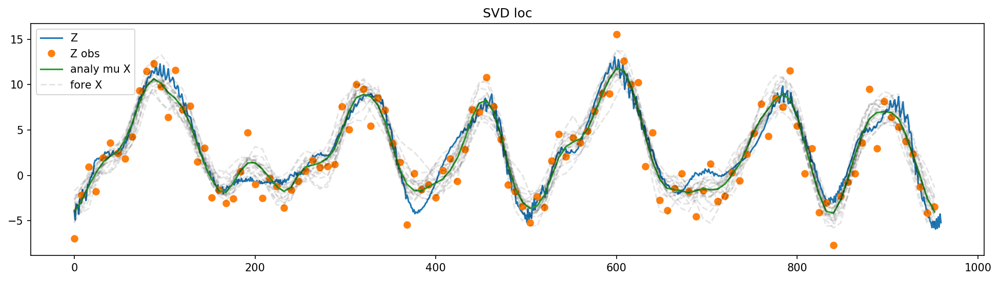

In [1025]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'X obs', 'fore mu X', 'fore X'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])
plt.title(atitle)

# With standard localization

In [957]:
atitle = 'standard loc'

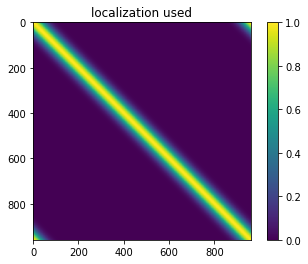

In [958]:
use_SVD_loc = False
[loc] = covariance.generate_circulant(N_Z, 1, 35, covariance.fft_sqd_exp_1d, return_Corr=True, return_eig=False)
imshow(loc, title='localization used')

X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse, use_SVD_loc=use_SVD_loc,
    rho=loc)

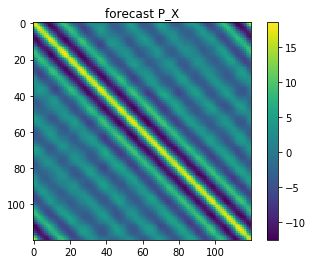

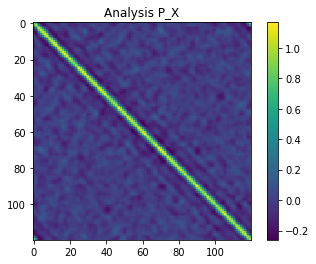

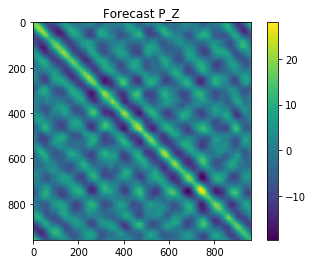

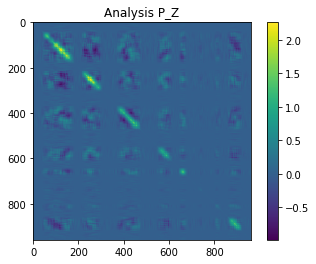

In [959]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, 'forecast P_X')
imshow(P_X_a, 'Analysis P_X')
imshow(P_Z_f, 'Forecast P_Z')
imshow(P_Z_a, 'Analysis P_Z')

Text(0.5,1,'standard loc')

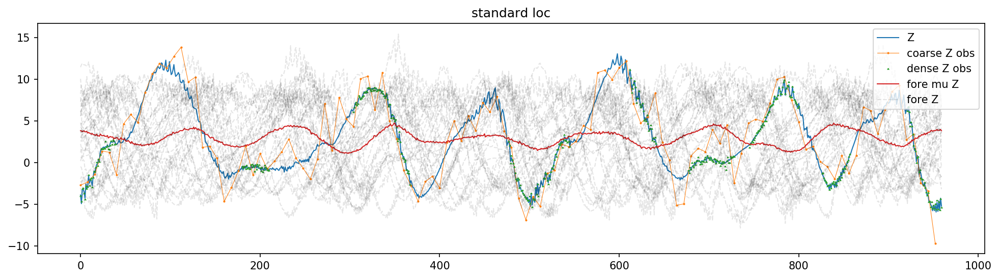

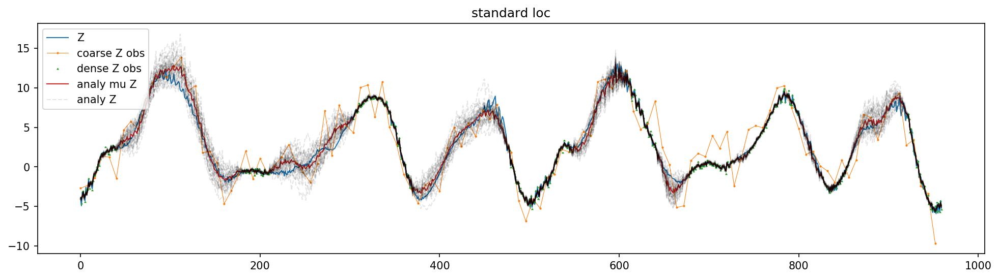

In [960]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])
plt.title(atitle)

Text(0.5,1,'Y analysis with standard loc; rmse: 0.32')

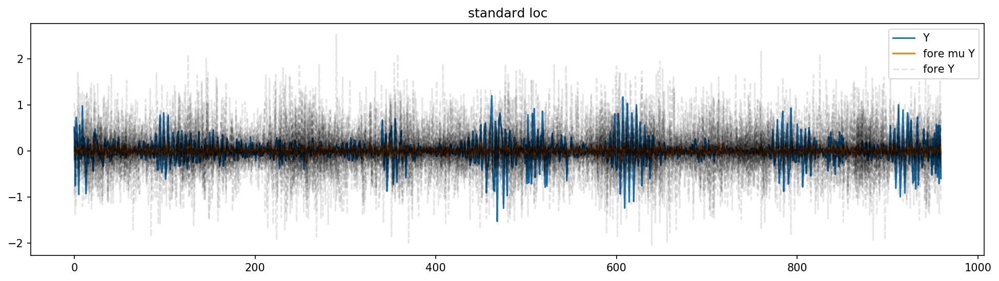

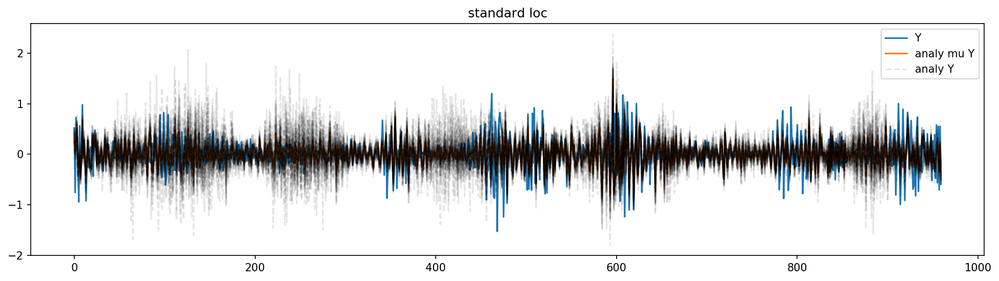

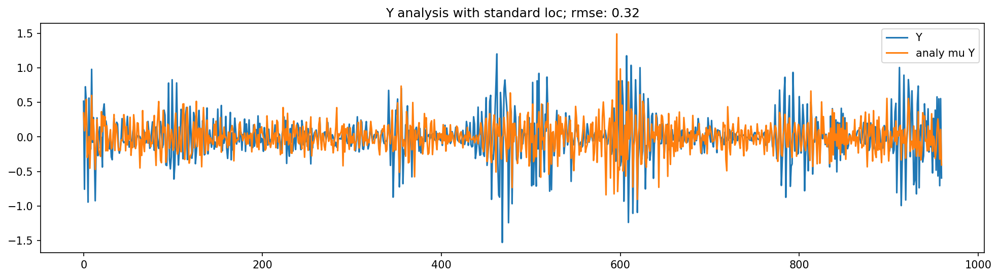

In [961]:
this_X_ens_f = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
this_Y_ens_f = Z0_ens - this_X_ens_f

this_X_ens_a = utilities.window_sum_Z(Z_ens_a, I=I, alpha=alpha, beta=beta)
this_Y_ens_a = Z_ens_a - this_X_ens_a


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_f, axis=-1))
plt.plot(this_Y_ens_f, 'k--', alpha=.1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.plot(this_Y_ens_a, 'k--', alpha=.1)
plt.legend(['Y', 'analy mu Y', 'analy Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.legend(['Y', 'analy mu Y'])

mu = np.mean(this_Y_ens_a, axis=-1)
rmse = np.sqrt(((mu - Y_GT[:, 0])**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with standard loc; rmse: 11.72')

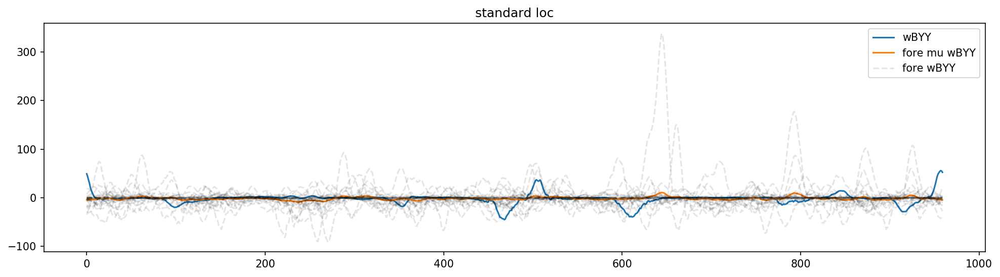

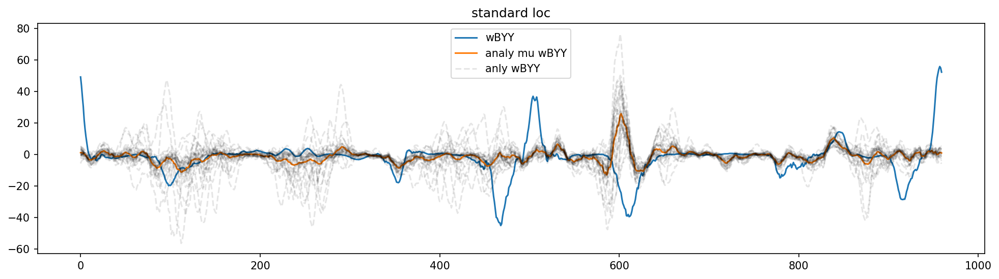

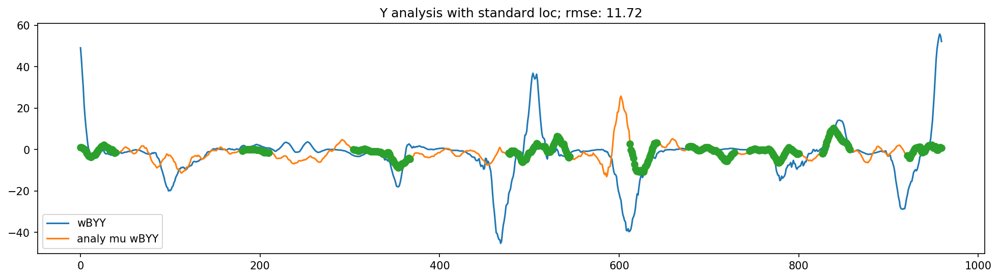

In [962]:
BYY_GT = b**2 * utilities.bracket([Y_GT[:, 0]], 1)
wBYY_GT = utilities.window_sum_Z(BYY_GT, I=I, alpha=alpha, beta=beta)

BYY_ens_f = b**2 * utilities.bracket([this_Y_ens_f], 1)
wBYY_ens_f = utilities.window_sum_Z(BYY_ens_f, I=I, alpha=alpha, beta=beta)

BYY_ens_a = b**2 * utilities.bracket([this_Y_ens_a], 1)
wBYY_ens_a = utilities.window_sum_Z(BYY_ens_a, I=I, alpha=alpha, beta=beta)

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_f, axis=-1))
plt.plot(wBYY_ens_f, 'k--', alpha=.1)
plt.legend(['wBYY', 'fore mu wBYY', 'fore wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(wBYY_ens_a, 'k--', alpha=.1)
plt.legend(['wBYY', 'analy mu wBYY', 'anly wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(Zd_obs_loc, np.mean(wBYY_ens_a, axis=-1)[Zd_obs_loc], 'o')
plt.legend(['wBYY', 'analy mu wBYY'])

mu = np.mean(wBYY_ens_a, axis=-1)
rmse = np.sqrt(((mu - wBYY_GT)**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'standard loc')

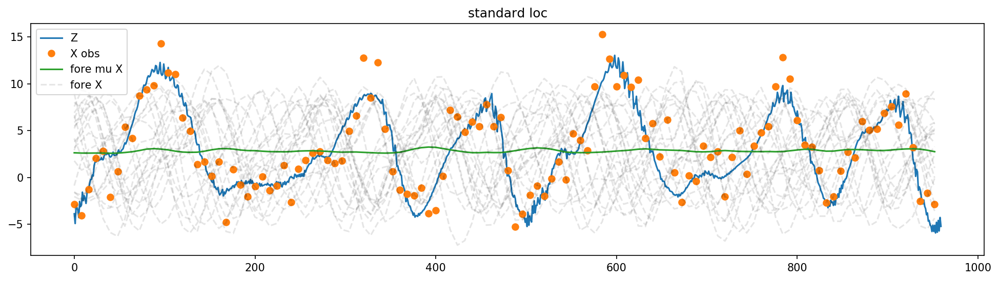

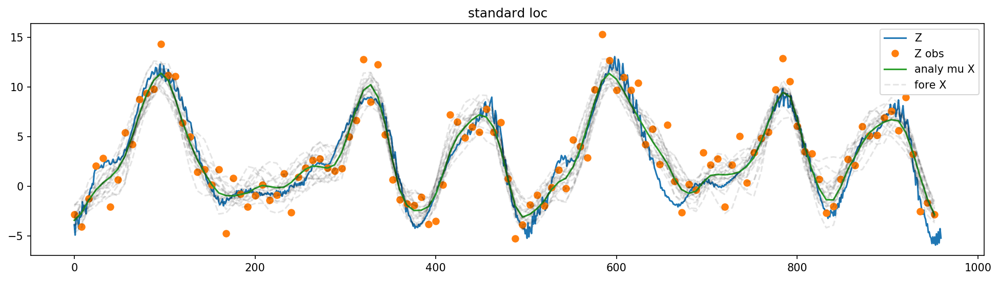

In [963]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'X obs', 'fore mu X', 'fore X'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])
plt.title(atitle)

# No localization

In [967]:
atitle = 'no loc'

In [968]:
use_SVD_loc = False
X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse, use_SVD_loc=use_SVD_loc)

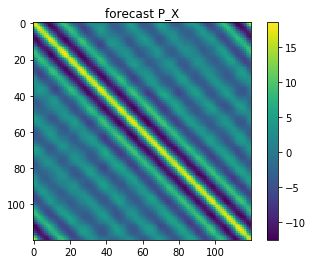

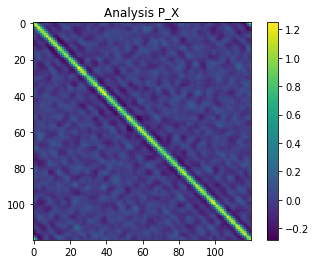

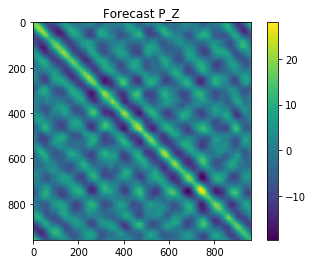

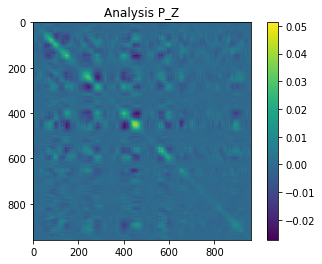

In [969]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, 'forecast P_X')
imshow(P_X_a, 'Analysis P_X')
imshow(P_Z_f, 'Forecast P_Z')
imshow(P_Z_a, 'Analysis P_Z')

Text(0.5,1,'no loc')

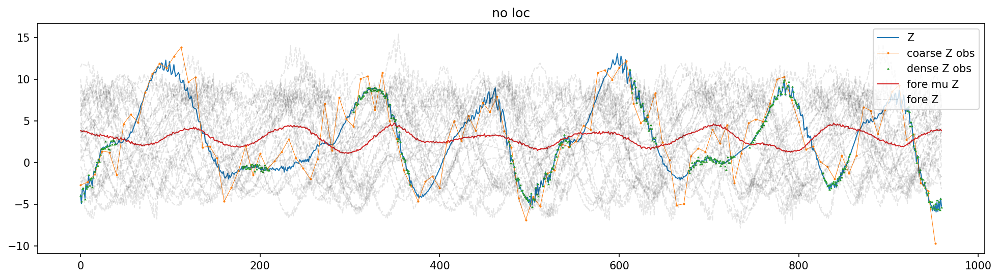

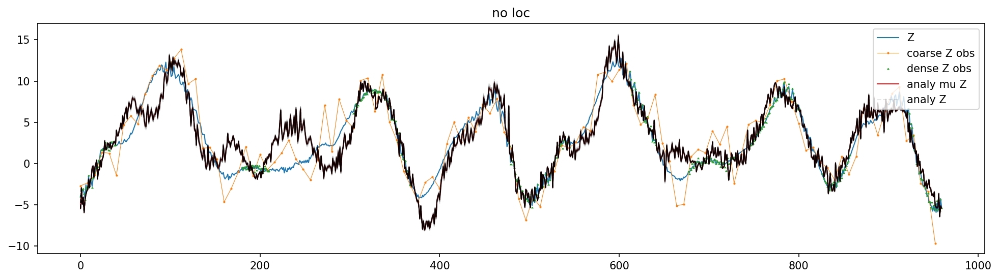

In [970]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])
plt.title(atitle)

Text(0.5,1,'Y analysis with no loc; rmse: 0.7581')

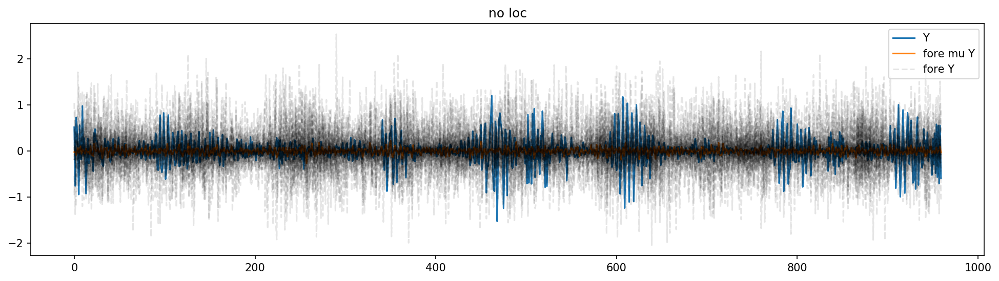

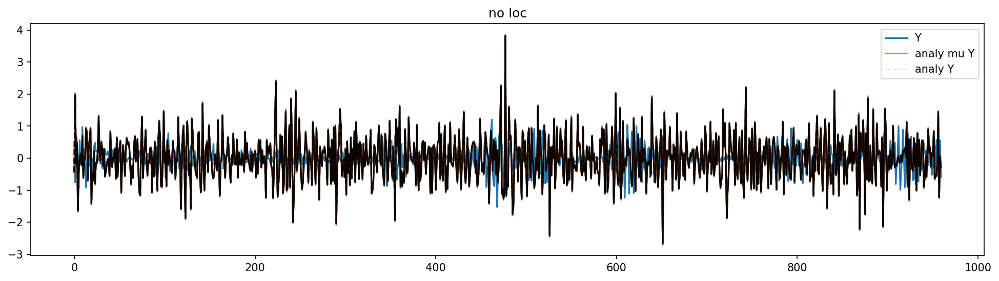

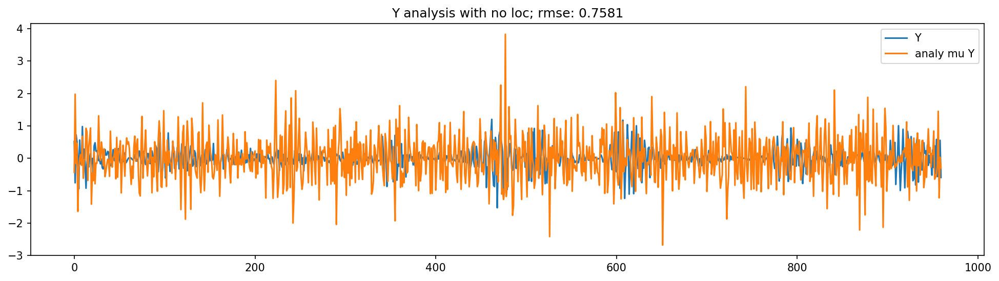

In [971]:
this_X_ens_f = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
this_Y_ens_f = Z0_ens - this_X_ens_f

this_X_ens_a = utilities.window_sum_Z(Z_ens_a, I=I, alpha=alpha, beta=beta)
this_Y_ens_a = Z_ens_a - this_X_ens_a


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_f, axis=-1))
plt.plot(this_Y_ens_f, 'k--', alpha=.1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.plot(this_Y_ens_a, 'k--', alpha=.1)
plt.legend(['Y', 'analy mu Y', 'analy Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.legend(['Y', 'analy mu Y'])

mu = np.mean(this_Y_ens_a, axis=-1)
rmse = np.sqrt(((mu - Y_GT[:, 0])**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with no loc; rmse: 30.41')

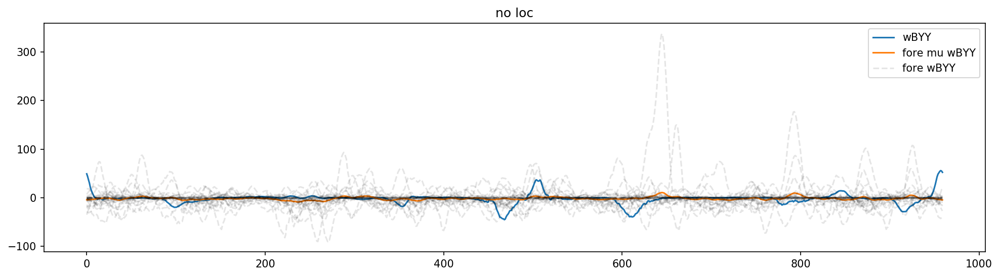

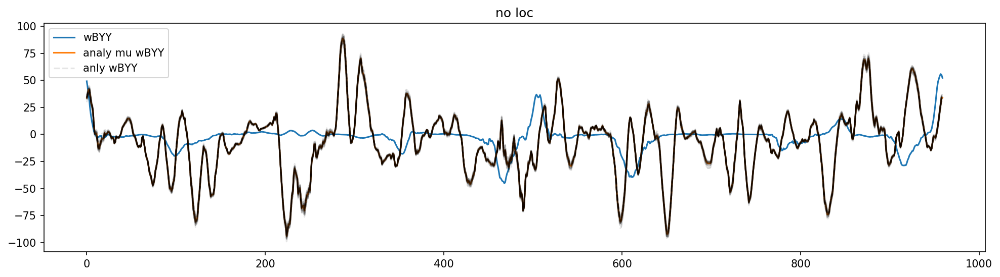

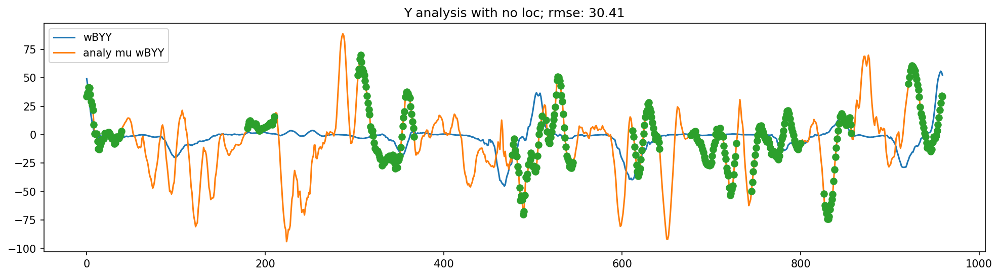

In [972]:
BYY_GT = b**2 * utilities.bracket([Y_GT[:, 0]], 1)
wBYY_GT = utilities.window_sum_Z(BYY_GT, I=I, alpha=alpha, beta=beta)

BYY_ens_f = b**2 * utilities.bracket([this_Y_ens_f], 1)
wBYY_ens_f = utilities.window_sum_Z(BYY_ens_f, I=I, alpha=alpha, beta=beta)

BYY_ens_a = b**2 * utilities.bracket([this_Y_ens_a], 1)
wBYY_ens_a = utilities.window_sum_Z(BYY_ens_a, I=I, alpha=alpha, beta=beta)

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_f, axis=-1))
plt.plot(wBYY_ens_f, 'k--', alpha=.1)
plt.legend(['wBYY', 'fore mu wBYY', 'fore wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(wBYY_ens_a, 'k--', alpha=.1)
plt.legend(['wBYY', 'analy mu wBYY', 'anly wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(Zd_obs_loc, np.mean(wBYY_ens_a, axis=-1)[Zd_obs_loc], 'o')
plt.legend(['wBYY', 'analy mu wBYY'])

mu = np.mean(wBYY_ens_a, axis=-1)
rmse = np.sqrt(((mu - wBYY_GT)**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'no loc')

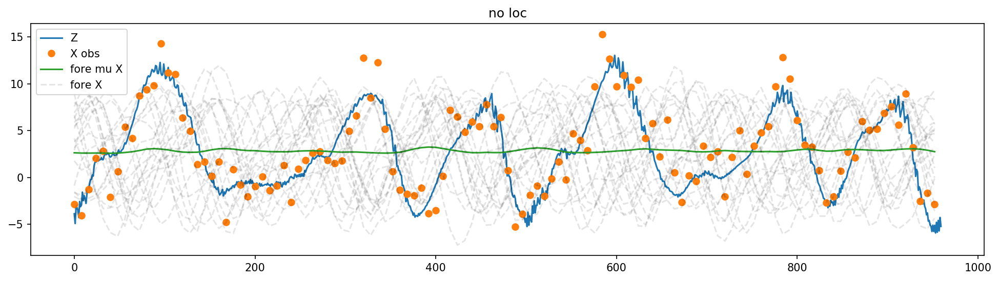

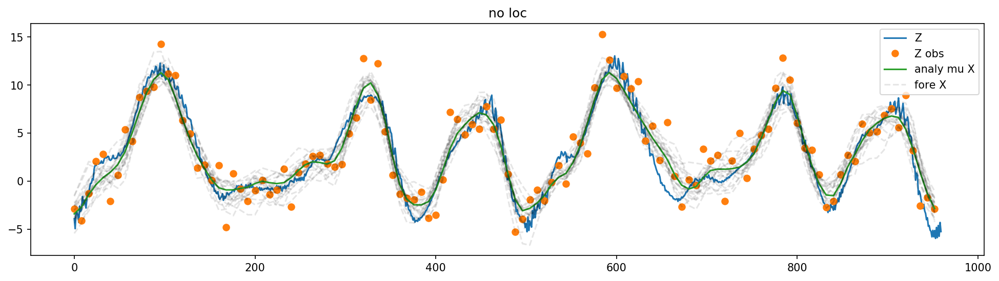

In [974]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'X obs', 'fore mu X', 'fore X'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])
plt.title(atitle)

# Use P_X localization

In [496]:
use_SVD_loc = False
use_P_X = True
X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X0_ens, Z0_ens, X_obs, Z_obs, H=H, R=R, R_coar=R_coar,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse,
    use_SVD_loc=use_SVD_loc,
    use_P_X=use_P_X)

In [944]:
atitle = 'SVD loc'

In [975]:
use_SVD_loc = False
use_P_X = True

X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse,
    use_SVD_loc=use_SVD_loc, use_P_X=use_P_X)

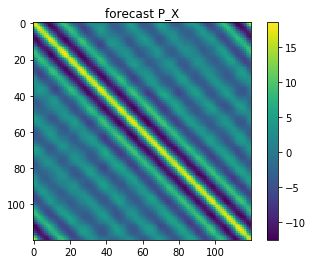

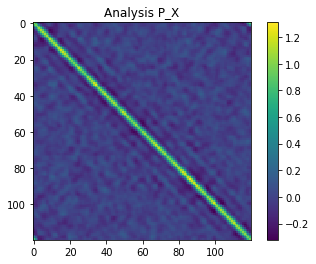

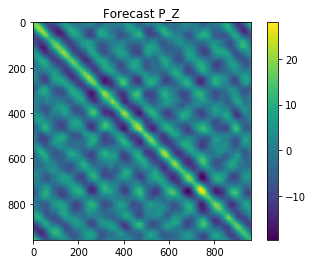

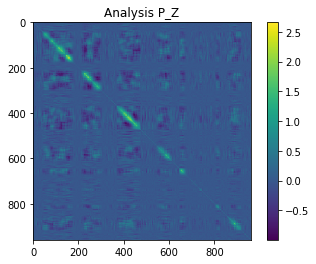

In [976]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, 'forecast P_X')
imshow(P_X_a, 'Analysis P_X')
imshow(P_Z_f, 'Forecast P_Z')
imshow(P_Z_a, 'Analysis P_Z')

Text(0.5,1,'no loc')

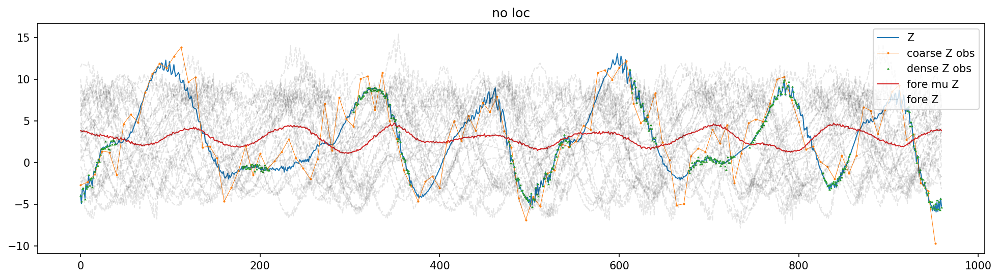

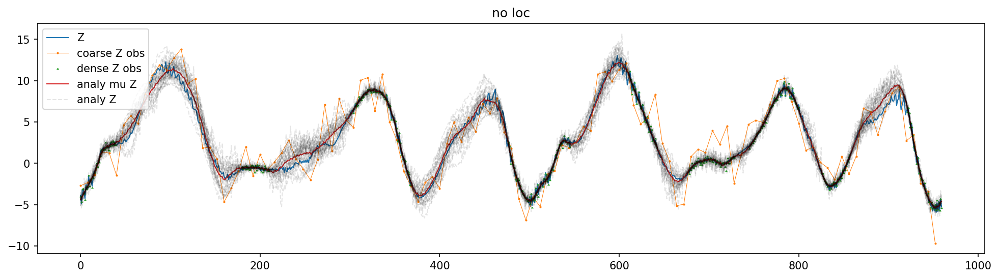

In [977]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])
plt.title(atitle)

Text(0.5,1,'Y analysis with no loc; rmse: 0.3033')

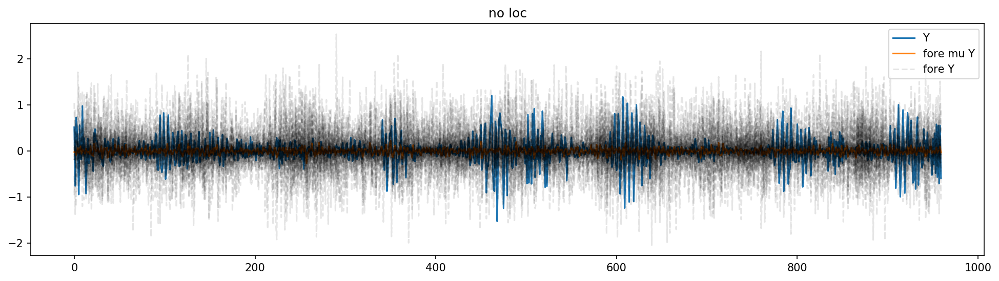

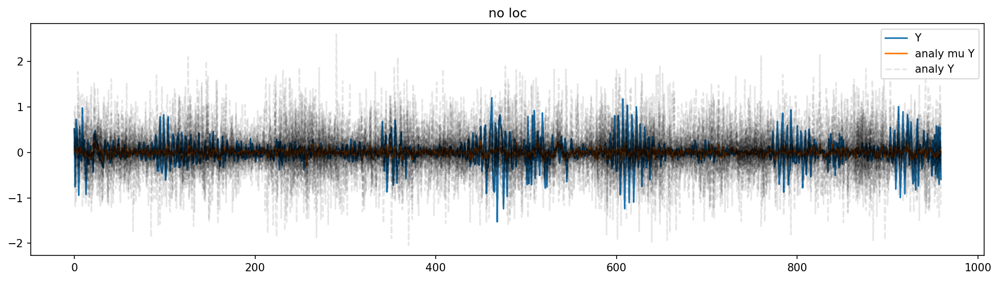

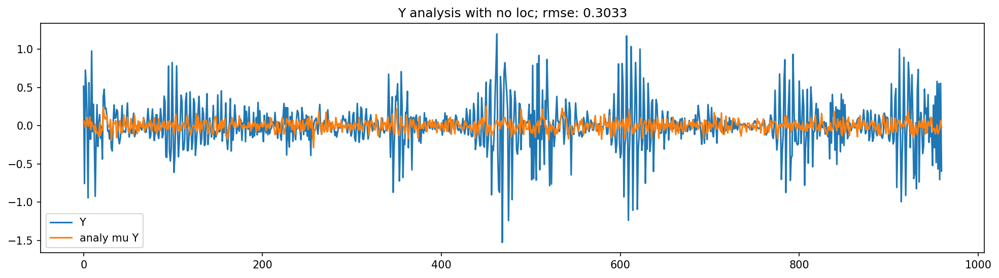

In [978]:
this_X_ens_f = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
this_Y_ens_f = Z0_ens - this_X_ens_f

this_X_ens_a = utilities.window_sum_Z(Z_ens_a, I=I, alpha=alpha, beta=beta)
this_Y_ens_a = Z_ens_a - this_X_ens_a


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_f, axis=-1))
plt.plot(this_Y_ens_f, 'k--', alpha=.1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.plot(this_Y_ens_a, 'k--', alpha=.1)
plt.legend(['Y', 'analy mu Y', 'analy Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.legend(['Y', 'analy mu Y'])

mu = np.mean(this_Y_ens_a, axis=-1)
rmse = np.sqrt(((mu - Y_GT[:, 0])**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with no loc; rmse: 11.57')

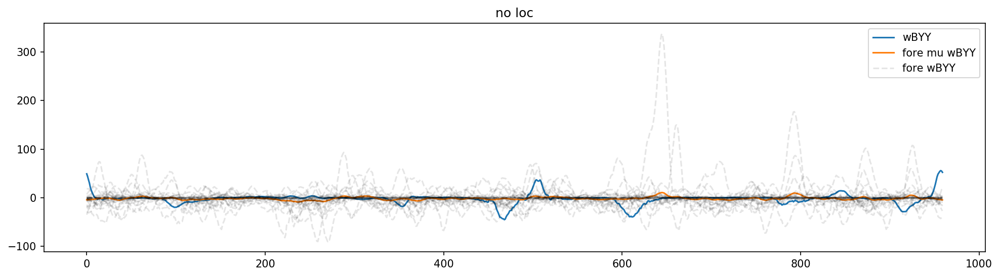

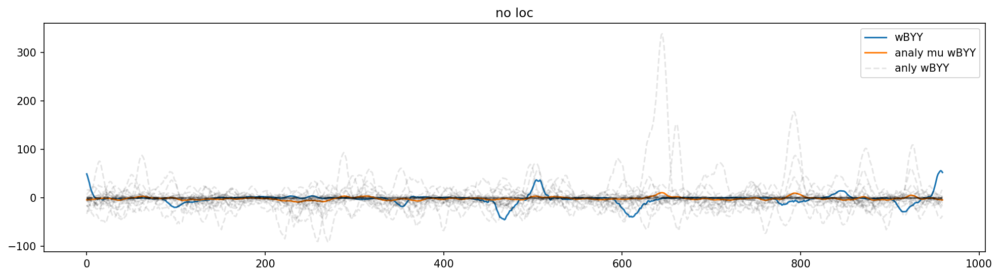

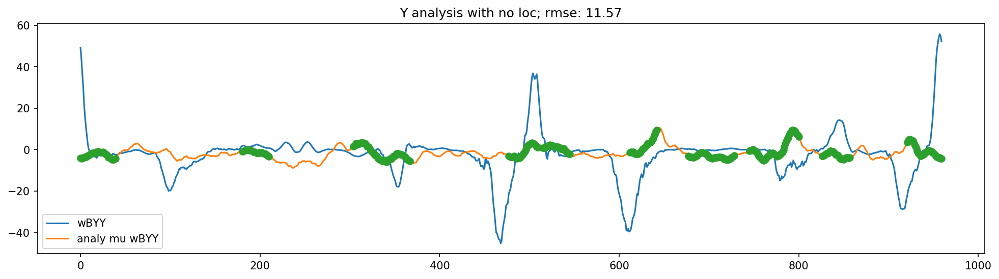

In [979]:
BYY_GT = b**2 * utilities.bracket([Y_GT[:, 0]], 1)
wBYY_GT = utilities.window_sum_Z(BYY_GT, I=I, alpha=alpha, beta=beta)

BYY_ens_f = b**2 * utilities.bracket([this_Y_ens_f], 1)
wBYY_ens_f = utilities.window_sum_Z(BYY_ens_f, I=I, alpha=alpha, beta=beta)

BYY_ens_a = b**2 * utilities.bracket([this_Y_ens_a], 1)
wBYY_ens_a = utilities.window_sum_Z(BYY_ens_a, I=I, alpha=alpha, beta=beta)

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_f, axis=-1))
plt.plot(wBYY_ens_f, 'k--', alpha=.1)
plt.legend(['wBYY', 'fore mu wBYY', 'fore wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(wBYY_ens_a, 'k--', alpha=.1)
plt.legend(['wBYY', 'analy mu wBYY', 'anly wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(Zd_obs_loc, np.mean(wBYY_ens_a, axis=-1)[Zd_obs_loc], 'o')
plt.legend(['wBYY', 'analy mu wBYY'])

mu = np.mean(wBYY_ens_a, axis=-1)
rmse = np.sqrt(((mu - wBYY_GT)**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'no loc')

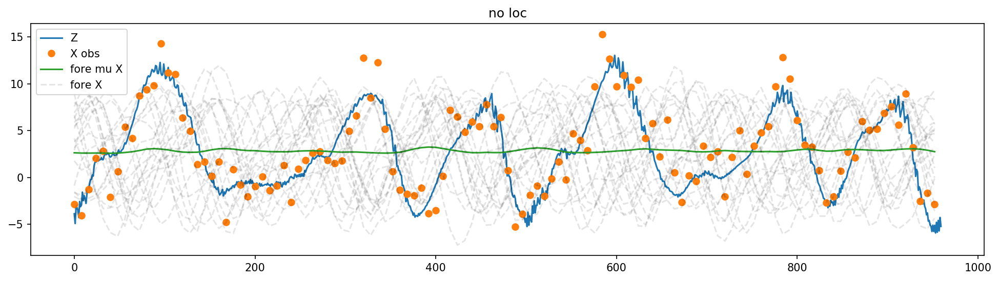

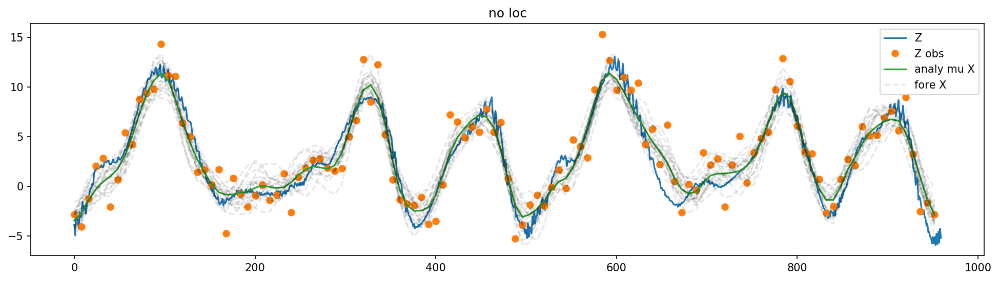

In [980]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'X obs', 'fore mu X', 'fore X'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])
plt.title(atitle)

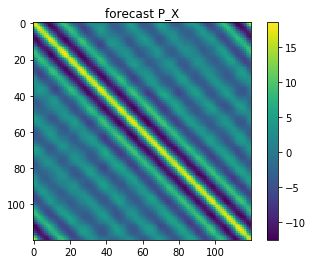

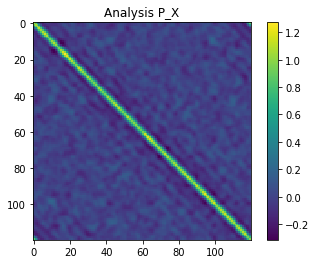

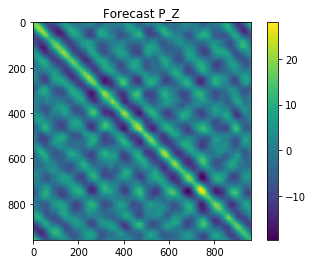

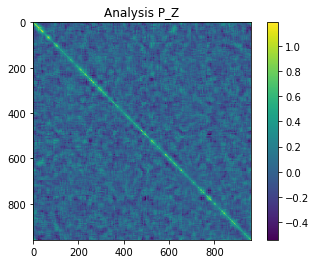

In [497]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, 'forecast P_X')
imshow(P_X_a, 'Analysis P_X')
imshow(P_Z_f, 'Forecast P_Z')
imshow(P_Z_a, 'Analysis P_Z')

Text(0.5,1,'Analysis with P_X loc; rmse: 0.5995')

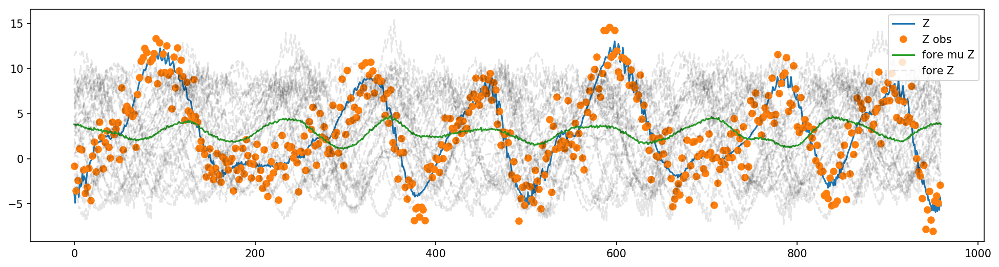

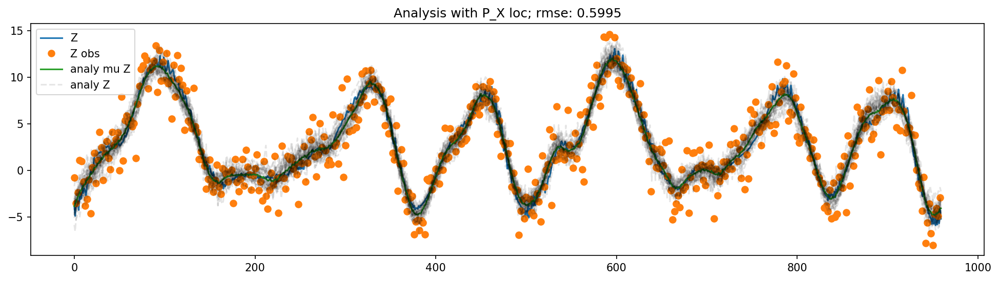

In [498]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_obs, Z_obs, 'o')
plt.plot(np.mean(Z0_ens, axis=-1))
plt.plot(Z0_ens, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_obs, Z_obs, 'o')
plt.plot(np.mean(Z_ens_a, axis=-1))
plt.plot(Z_ens_a, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

mu = np.mean(Z_ens_a, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Analysis with P_X loc; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with P_X loc; rmse: 0.3048')

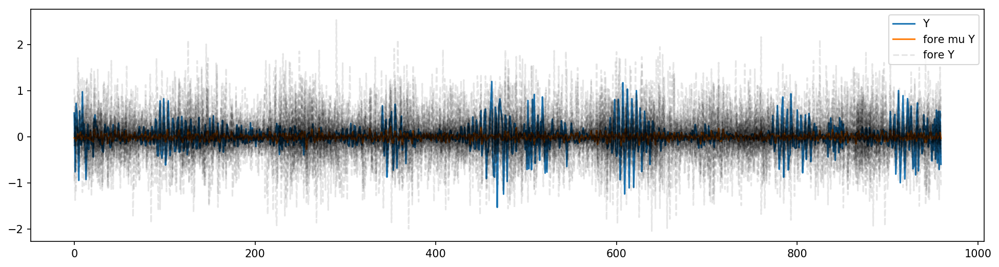

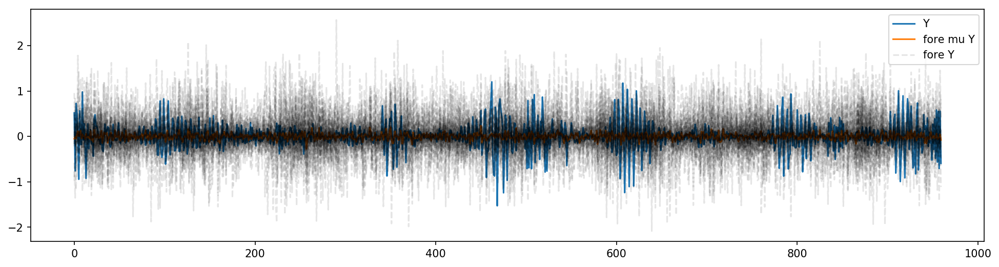

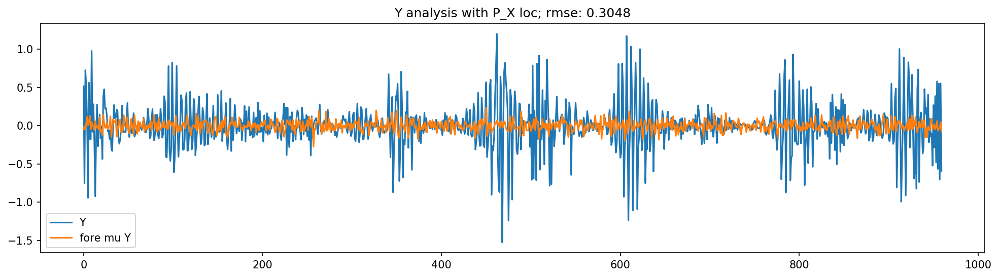

In [499]:
this_X_ens_f = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
this_Y_ens_f = Z0_ens - this_X_ens_f

this_X_ens_a = utilities.window_sum_Z(Z_ens_a, I=I, alpha=alpha, beta=beta)
this_Y_ens_a = Z_ens_a - this_X_ens_a


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_f, axis=-1))
plt.plot(this_Y_ens_f, 'k--', alpha=.1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.plot(this_Y_ens_a, 'k--', alpha=.1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.legend(['Y', 'fore mu Y'])

mu = np.mean(this_Y_ens_a, axis=-1)
rmse = np.sqrt(((mu - Y_GT[:, 0])**2).mean())
plt.title(f'Y analysis with P_X loc; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with P_X localization; rmse: 11.58')

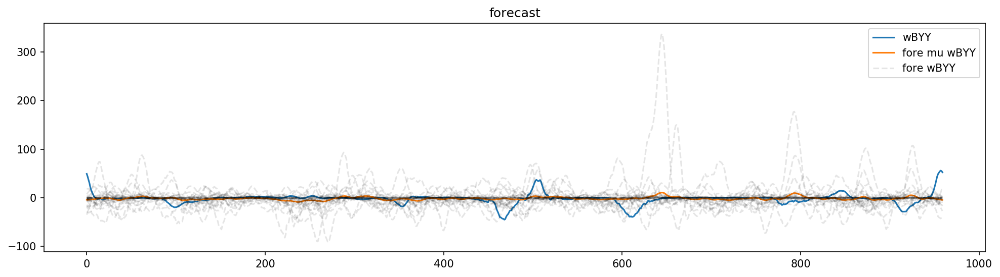

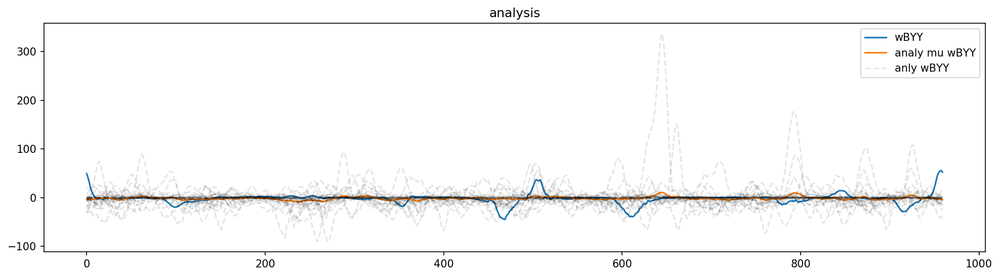

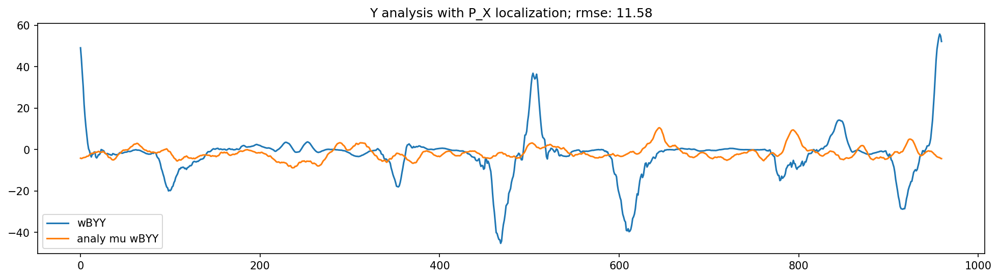

In [500]:
BYY_GT = b**2 * utilities.bracket([Y_GT[:, 0]], 1)
wBYY_GT = utilities.window_sum_Z(BYY_GT, I=I, alpha=alpha, beta=beta)

BYY_ens_f = b**2 * utilities.bracket([this_Y_ens_f], 1)
wBYY_ens_f = utilities.window_sum_Z(BYY_ens_f, I=I, alpha=alpha, beta=beta)

BYY_ens_a = b**2 * utilities.bracket([this_Y_ens_a], 1)
wBYY_ens_a = utilities.window_sum_Z(BYY_ens_a, I=I, alpha=alpha, beta=beta)

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_f, axis=-1))
plt.plot(wBYY_ens_f, 'k--', alpha=.1)
plt.legend(['wBYY', 'fore mu wBYY', 'fore wBYY'])
plt.title('forecast')

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(wBYY_ens_a, 'k--', alpha=.1)
plt.legend(['wBYY', 'analy mu wBYY', 'anly wBYY'])
plt.title('analysis')

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.legend(['wBYY', 'analy mu wBYY'])

mu = np.mean(wBYY_ens_a, axis=-1)
rmse = np.sqrt(((mu - wBYY_GT)**2).mean())
plt.title(f'Y analysis with P_X localization; rmse: {rmse:0.4}')

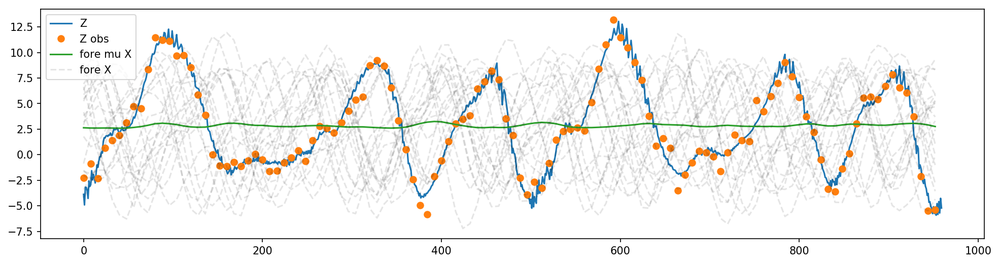

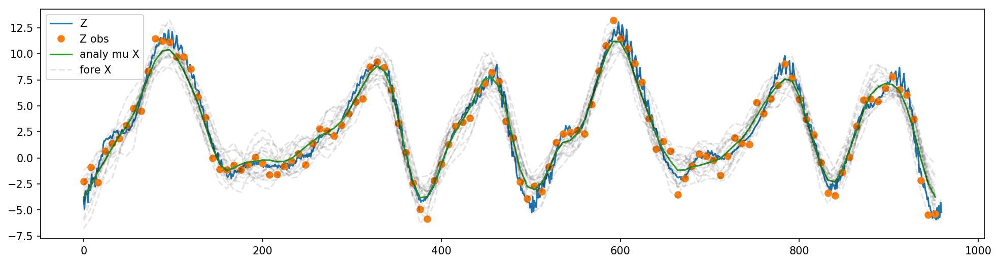

In [501]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'fore mu X', 'fore X'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])

In [69]:
X_coar_ens_ts = return_LM3_coar_ens_data(
    X0_ens, t[0: 20], Z_ens_ts, coarse=coarse, K=K, I=I, F=F, b=b, c=c, alpha=alpha, beta=beta)

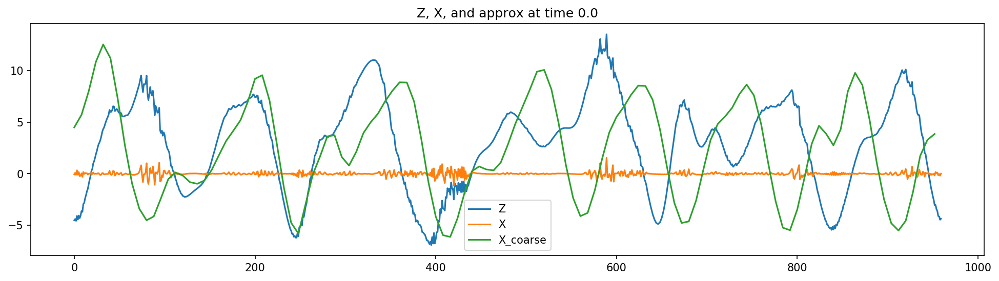

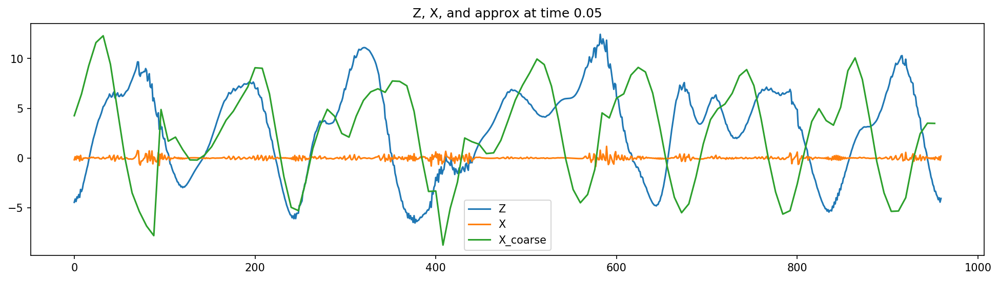

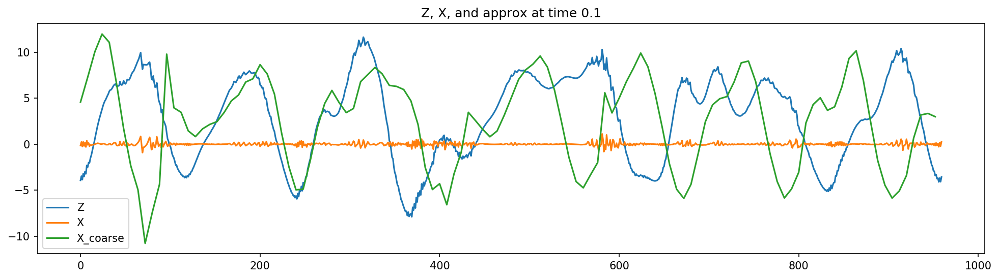

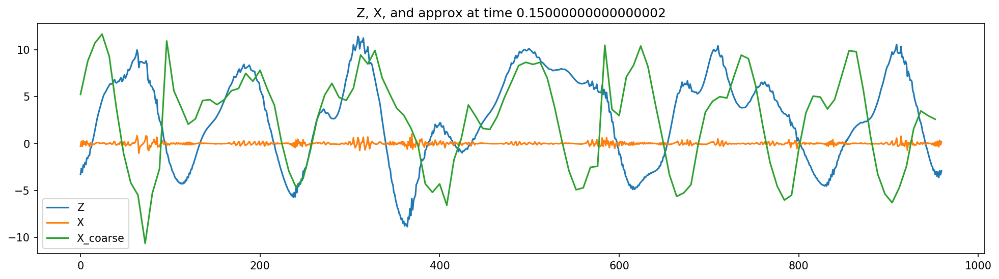

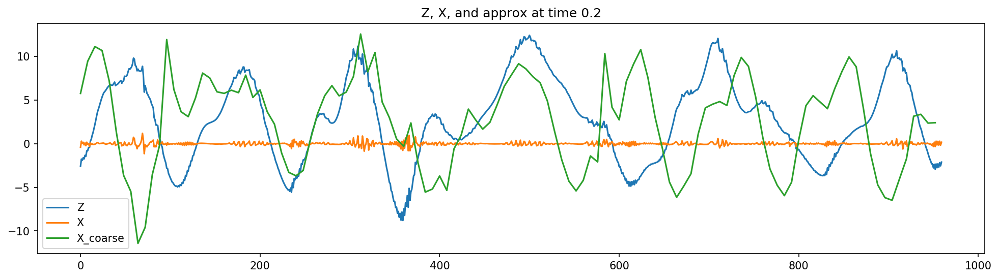

...

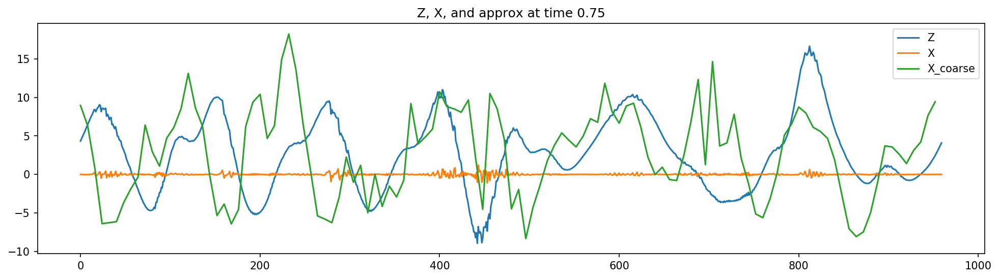

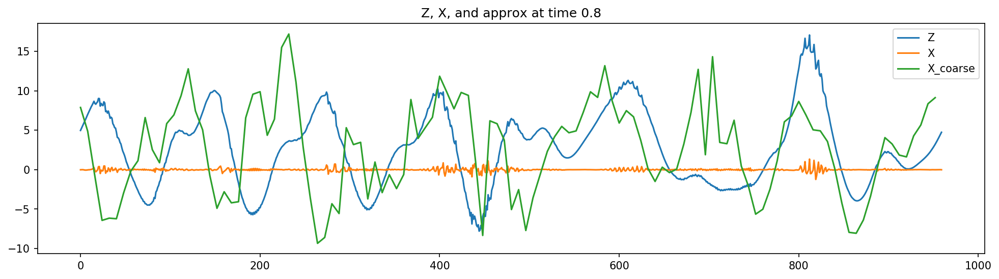

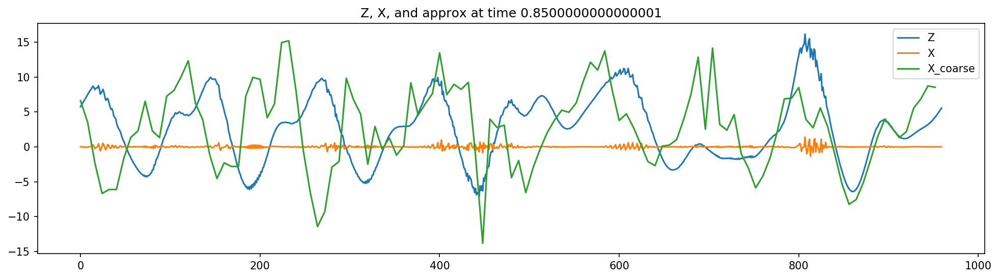

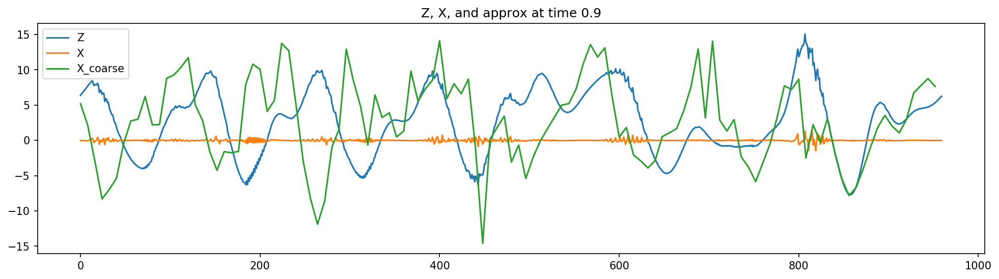

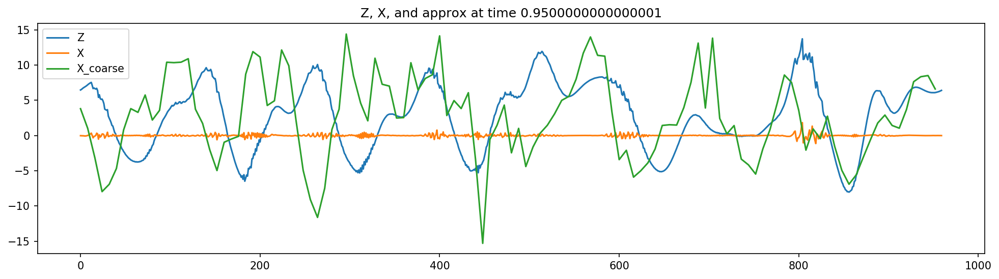

In [71]:
num_steps = 20
ens_num = 0
z_ens_num = int(np.floor(ens_num/(N_eX/N_eZ)))
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    X_to_plot = X_coar_ens_ts[:, ens_num, ii]
    Z_to_plot = Z_ens_ts[:, z_ens_num, ii]
    Y_to_plot = window_sum_Z(Z_to_plot, I=I, alpha=alpha, beta=beta)
    Y_to_plot = Z_to_plot - Y_to_plot
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.plot(Y_to_plot)
    plt.plot(np.arange(0, N_Z, coarse), X_to_plot)
    plt.title(f'Z, X, and approx at time {t[ii]}')
    plt.legend(['Z', 'X', 'X_coarse', 'X_LM3_coar'])

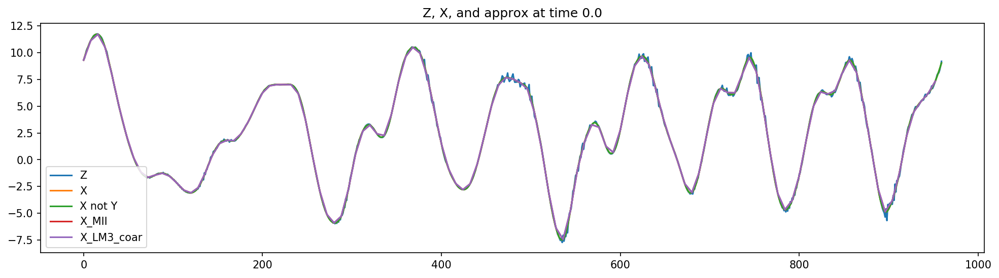

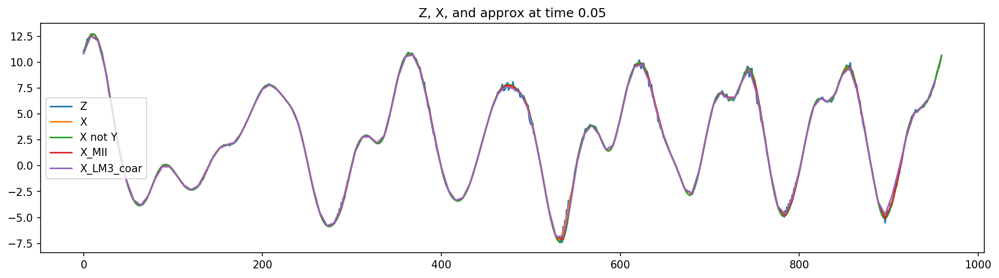

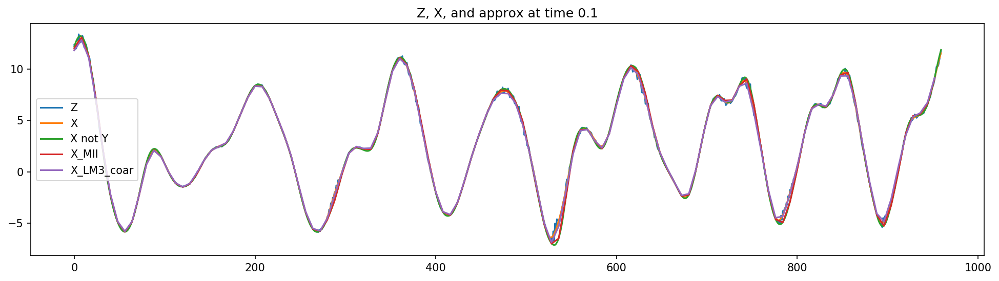

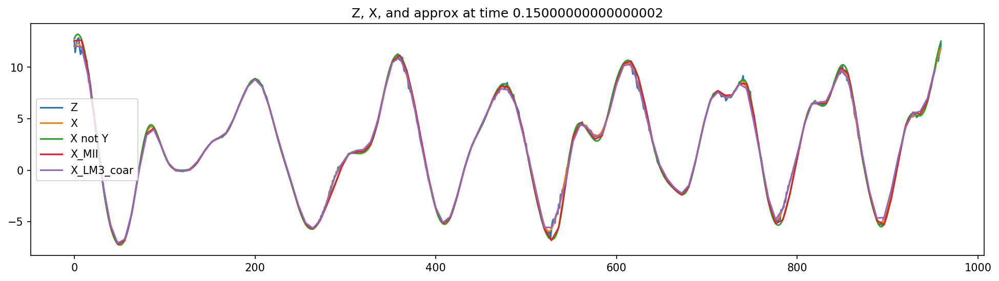

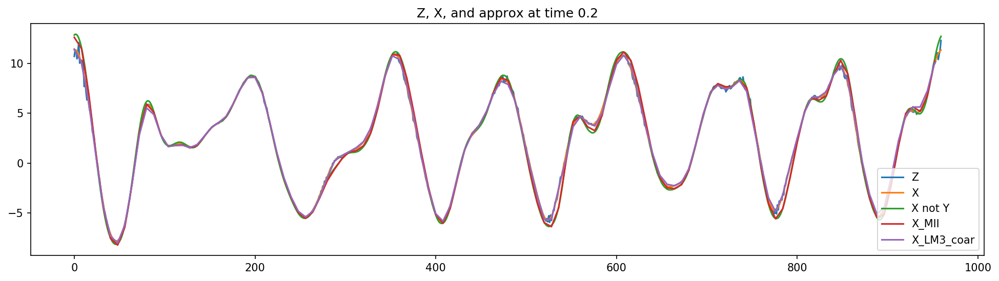

...

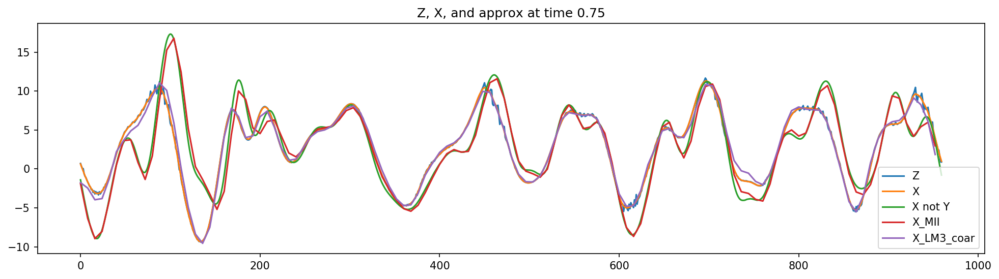

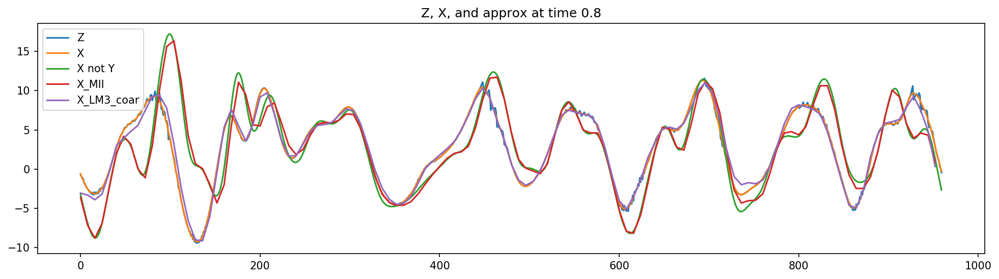

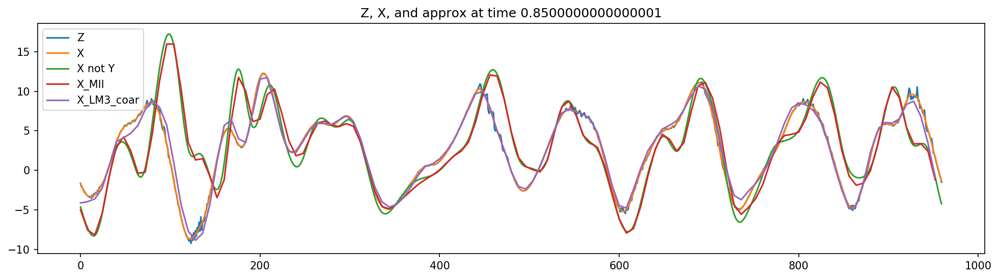

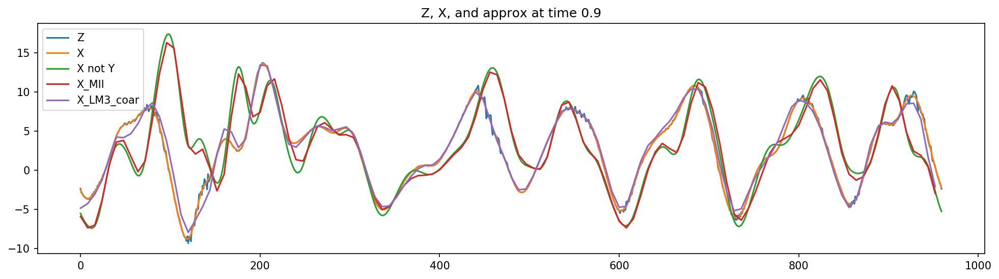

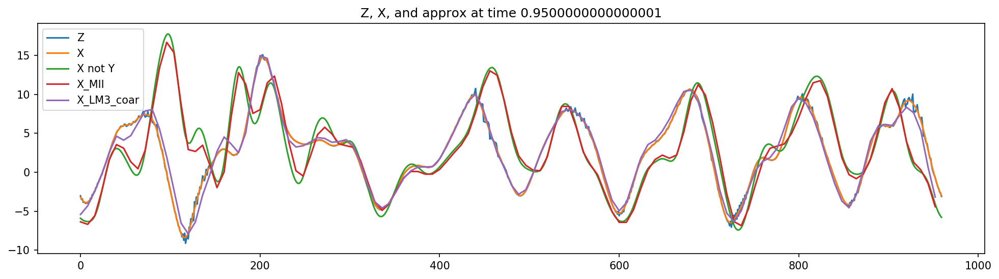

In [313]:
num_steps = 20
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    Z_to_plot = Z_GT[:, ii]
    X_to_plot = X_GT[:, ii]
    X_coarse_to_plot = X_coarse_GT[:, ii]
    X_LM3_coar_to_plot = X_LM3_coar[:, ii]
    X_not_Y_to_plot = X_not_Y_GT[:, ii]
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.plot(X_to_plot)
    plt.plot(X_not_Y_to_plot)
        
    plt.plot(x[::8], X_coarse_to_plot)
    plt.plot(x[::8], X_LM3_coar_to_plot)
    
    plt.title(f'Z, X, and approx at time {t[ii]}')
    plt.legend(['Z', 'X', 'X not Y', 'X_MII', 'X_LM3_coar'])

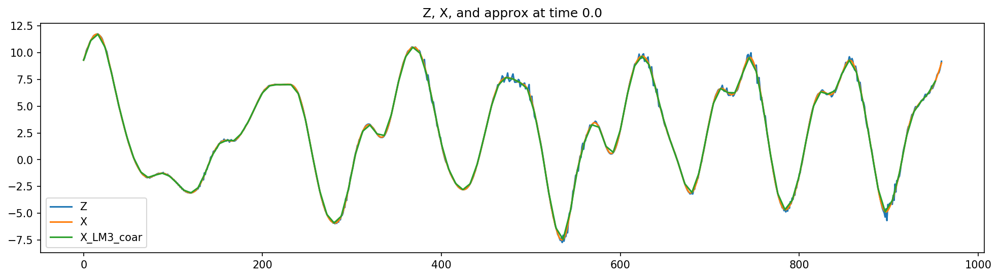

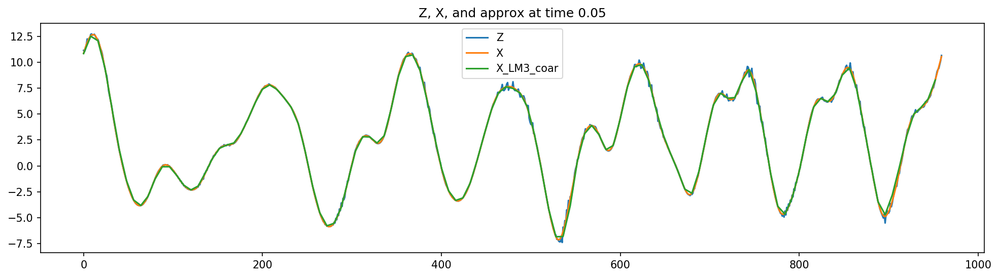

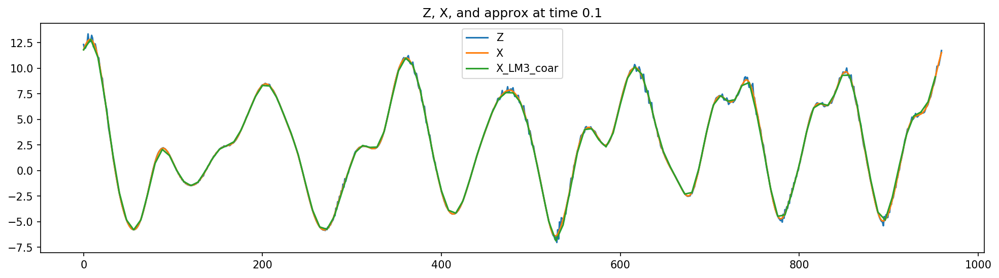

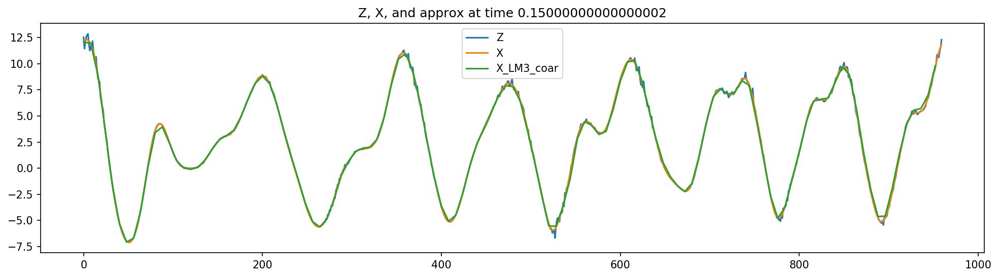

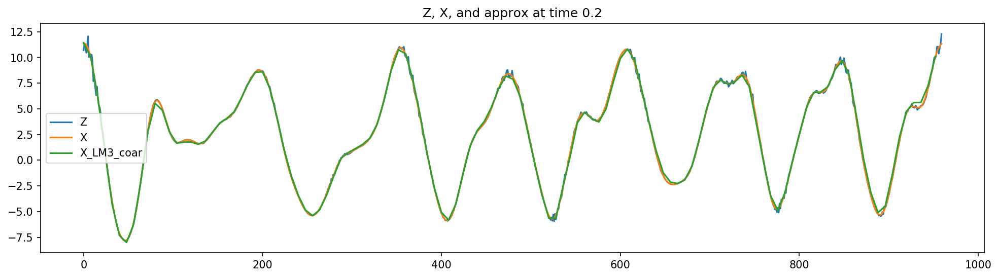

...

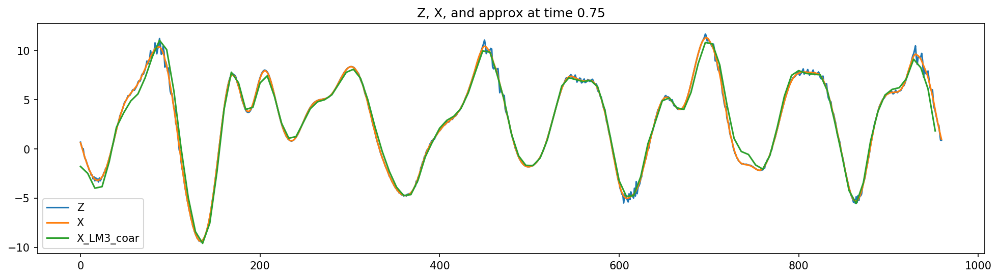

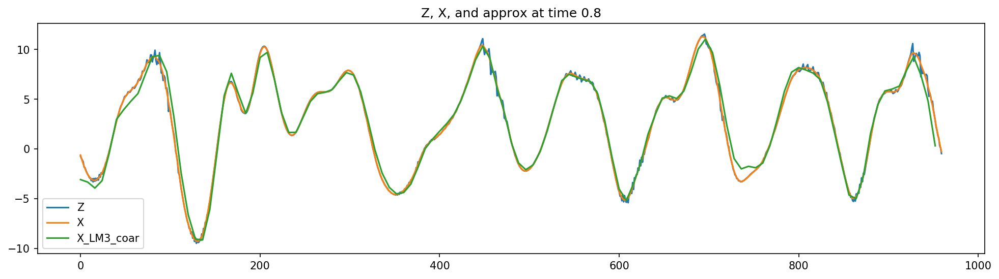

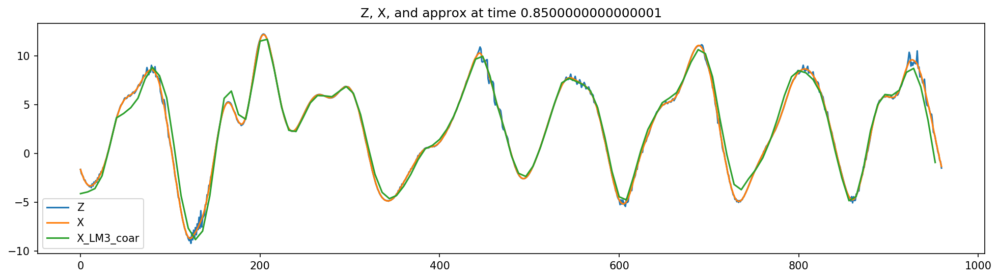

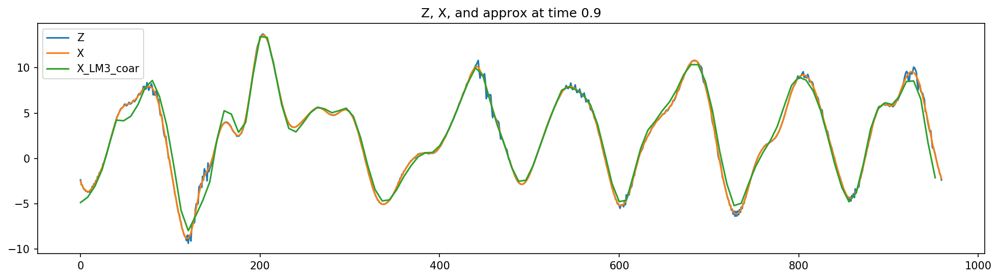

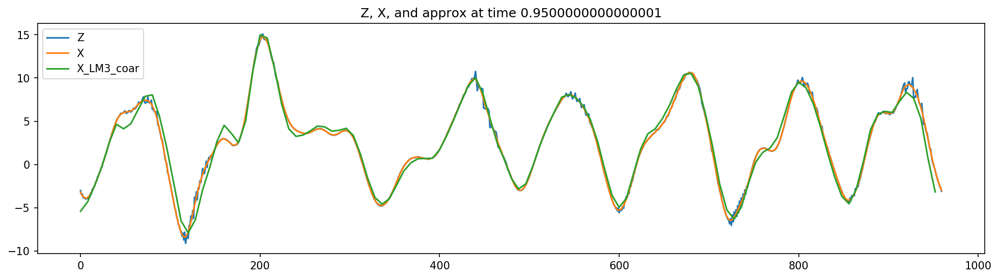

In [314]:
num_steps = 20
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    Z_to_plot = Z_GT[:, ii]
    X_to_plot = X_GT[:, ii]
    X_LM3_coar_to_plot = X_LM3_coar[:, ii]
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.plot(X_to_plot)
    plt.plot(x[::8], X_LM3_coar_to_plot)
    
    plt.title(f'Z, X, and approx at time {t[ii]}')
    plt.legend(['Z', 'X', 'X_LM3_coar'])

In [315]:
def LM3_return_terms(Z, K=32, I=12, F=15, b=10, c=2.5, alpha=None, beta=None):
    if alpha is None:
        alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
    if beta is None:
        beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)
    X = window_sum_Z(Z, I=I, alpha=alpha, beta=beta)
    Y = Z - X
    
    BXXK = bracket([X], K)
    BYY = b**2 * bracket([Y], 1)
    BYX = c * bracket([Y, X], 1)
    nX = -1 * X
    nY = -b * Y
    
    dZdt = BXXK + BYY + BYX + nX + nY + F
    return dZdt, BXXK, BYY, BYX, nX, nY, F

In [316]:
dZdt, BXXK, BYY, BYX, nX, nY, F = LM3_return_terms(Z_GT, K=K, I=I, F=F, b=b, c=c)

In [317]:
BXXK.shape

(960, 20001)

In [318]:
dZdt.shape

(960, 20001)

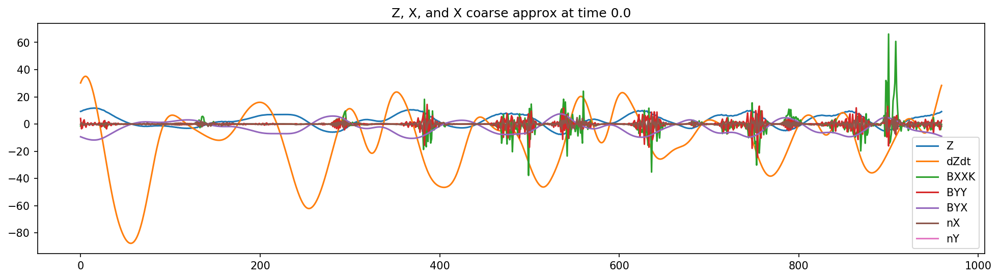

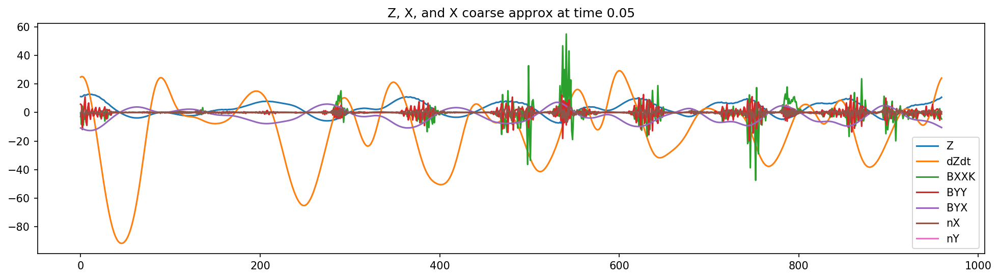

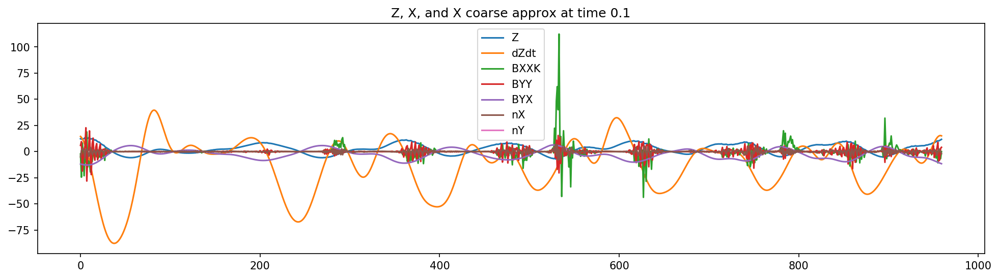

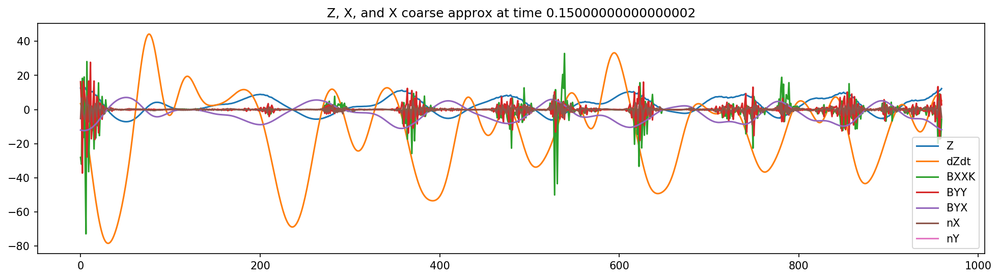

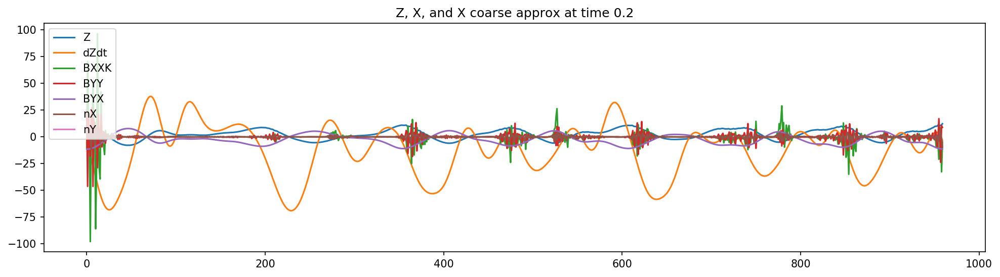

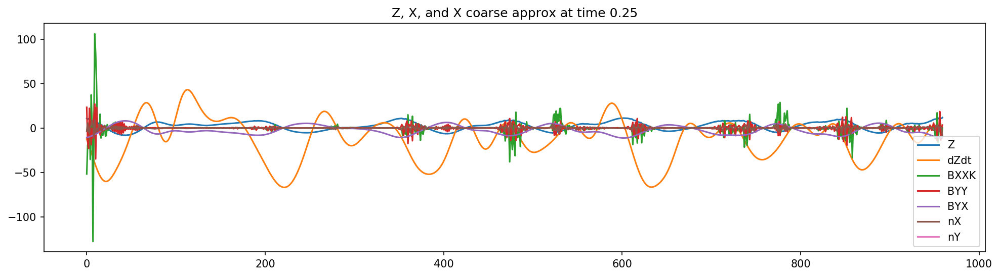

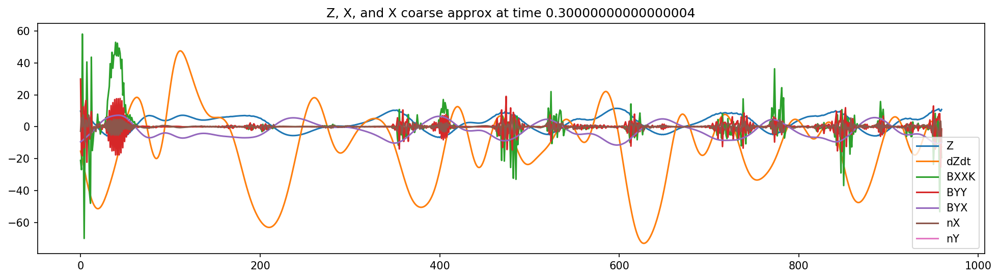

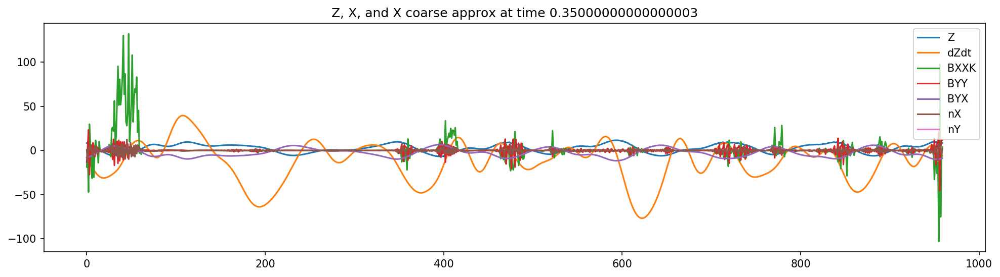

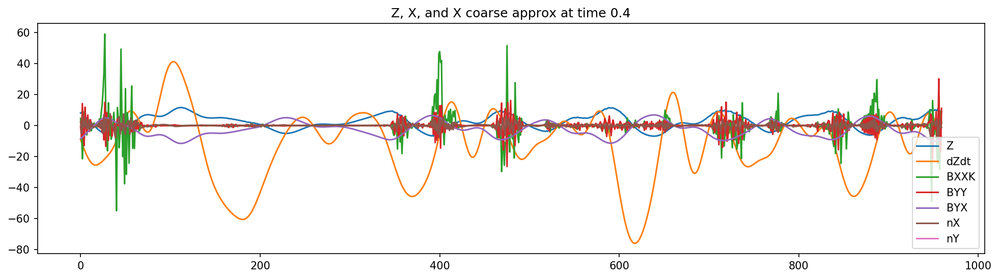

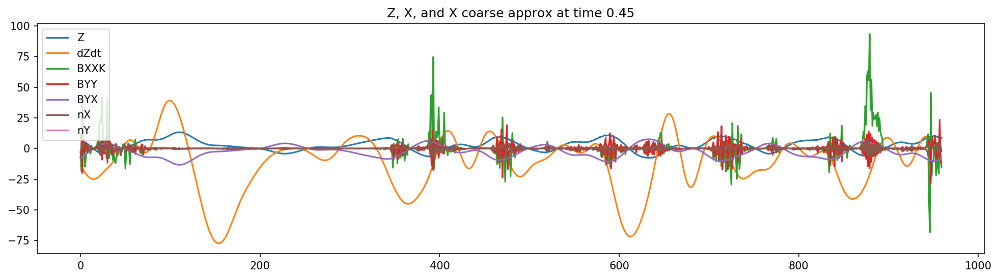

In [319]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_GT[:, ii])
    plt.plot(BXXK[:, ii])
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(F)
    plt.title(f'Z, X, and X coarse approx at time {t[ii]}')
    plt.legend(['Z', 'dZdt', 'BXXK', 'BYY', 'BYX', 'nX', 'nY', F])

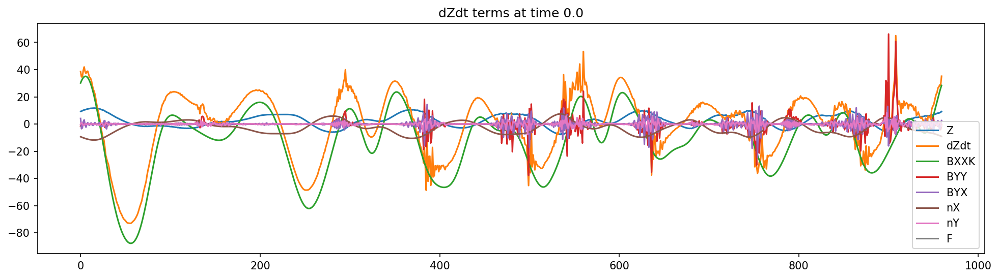

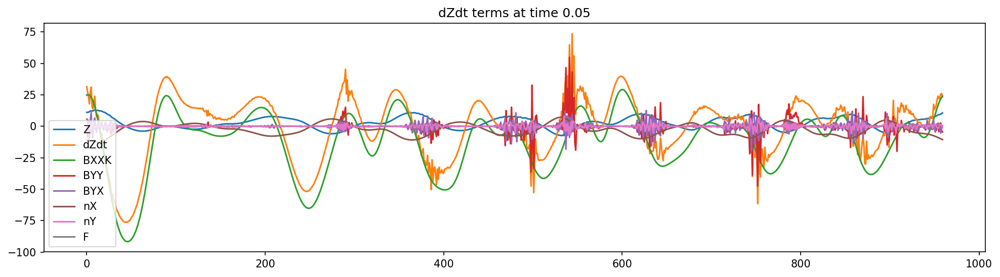

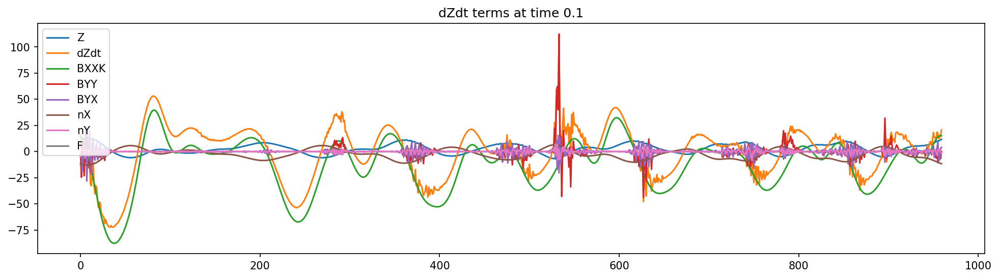

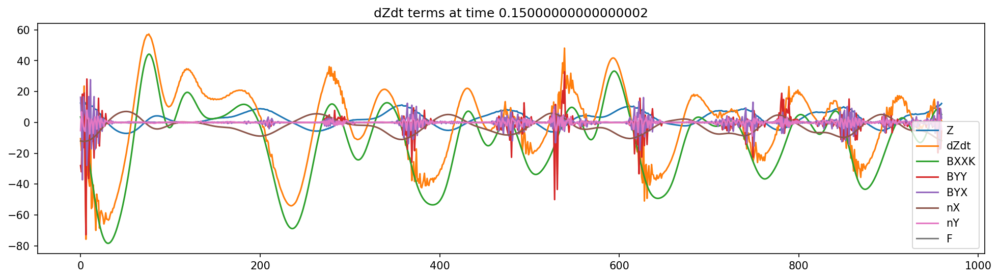

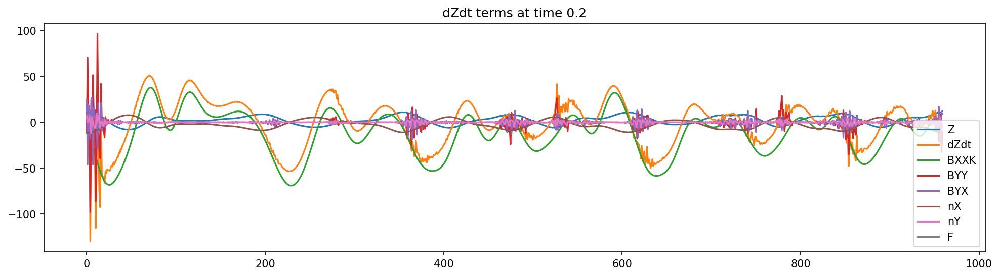

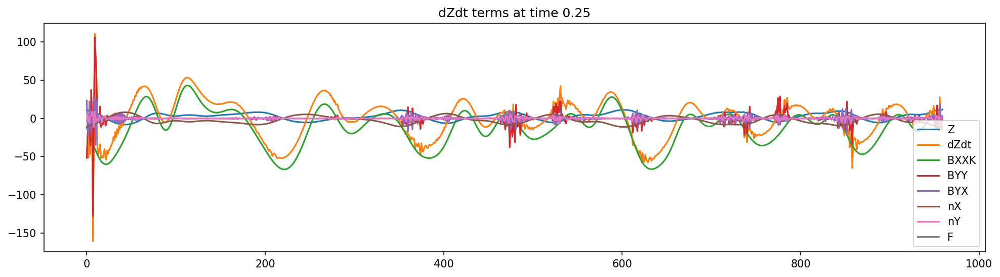

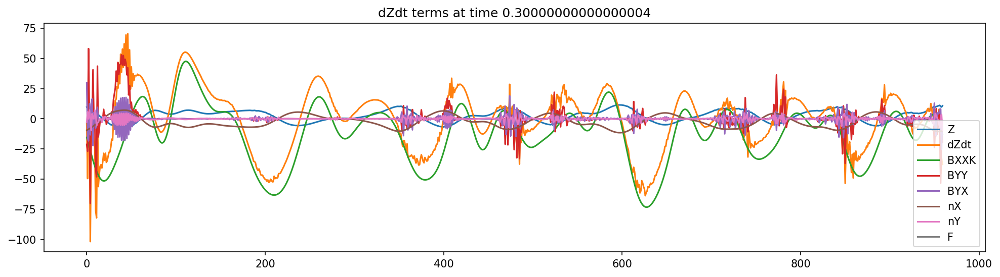

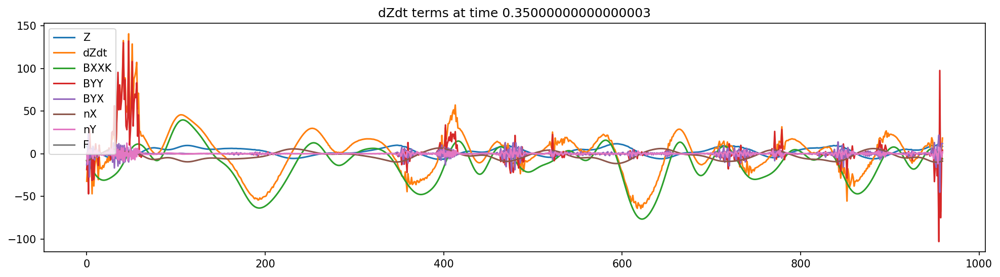

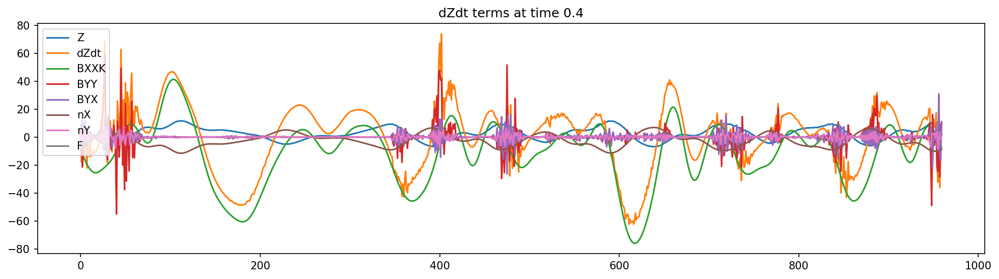

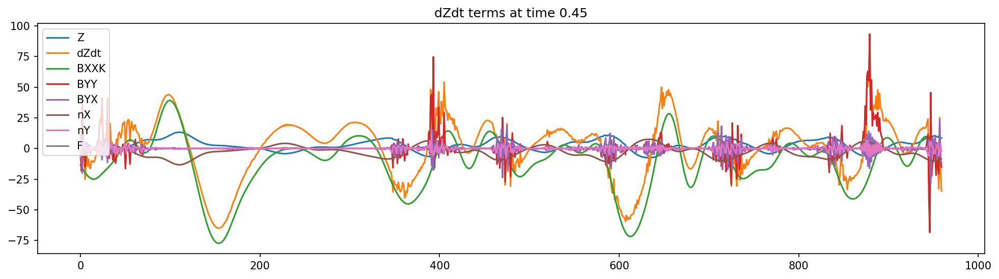

In [320]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_GT[:, ii])
    plt.plot(dZdt[:, ii])
    plt.plot(BXXK[:, ii])
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(F)
    plt.title(f'dZdt terms at time {t[ii]}')
    plt.legend(['Z', 'dZdt', 'BXXK', 'BYY', 'BYX', 'nX', 'nY', 'F'])

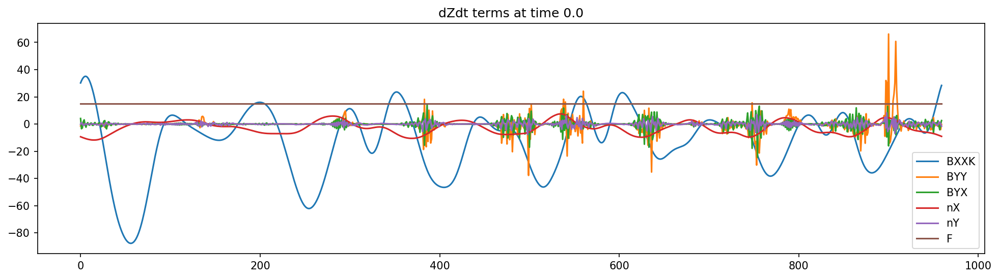

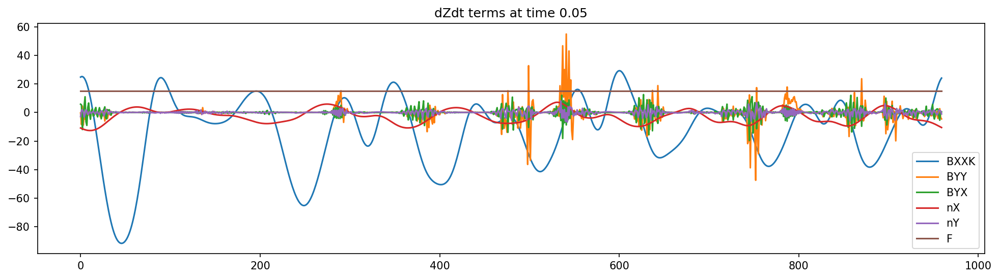

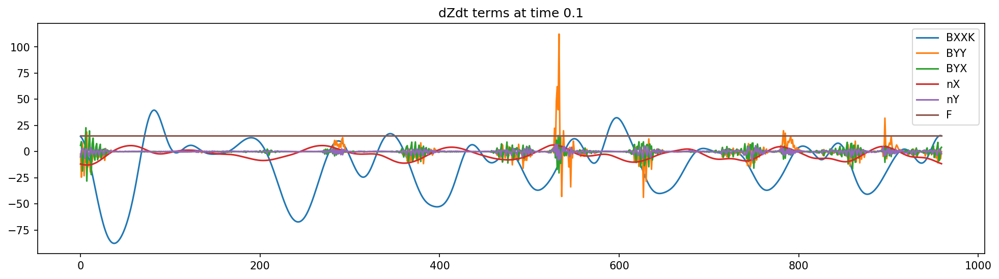

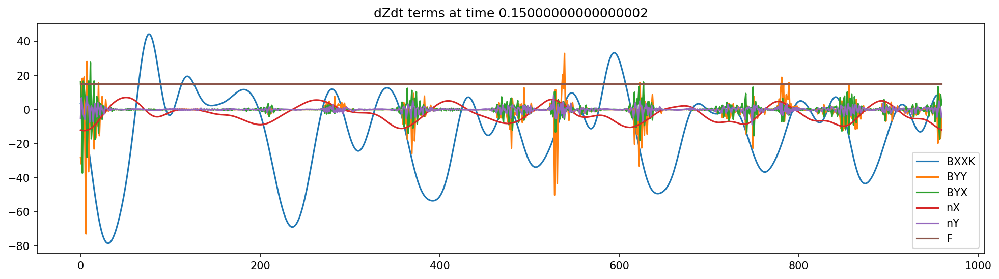

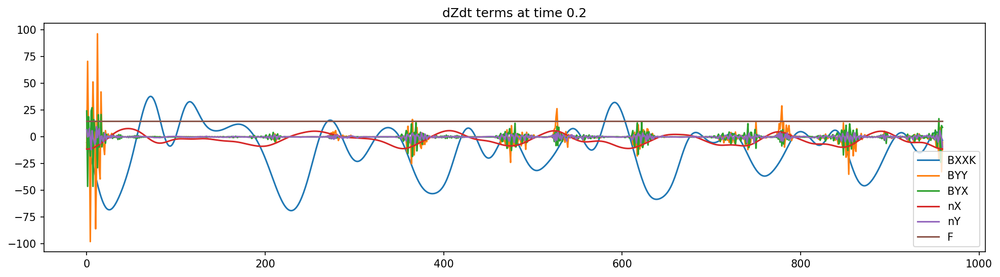

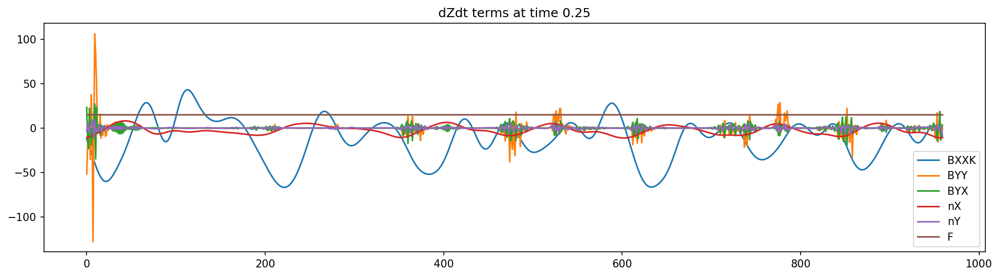

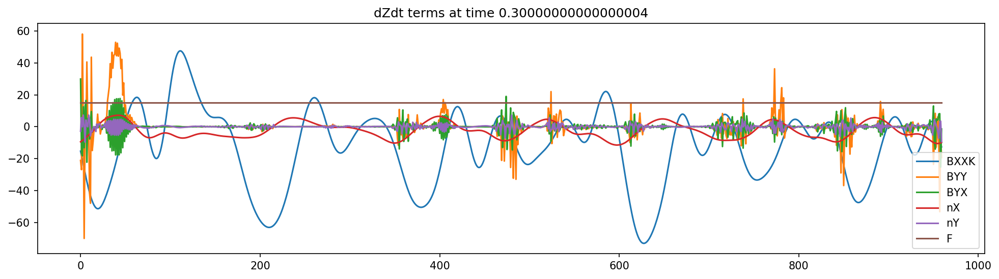

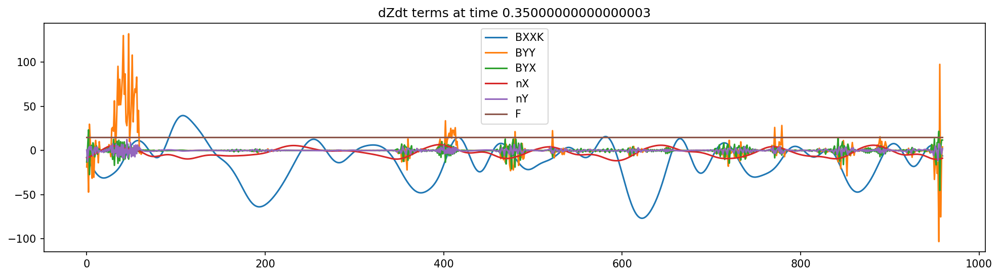

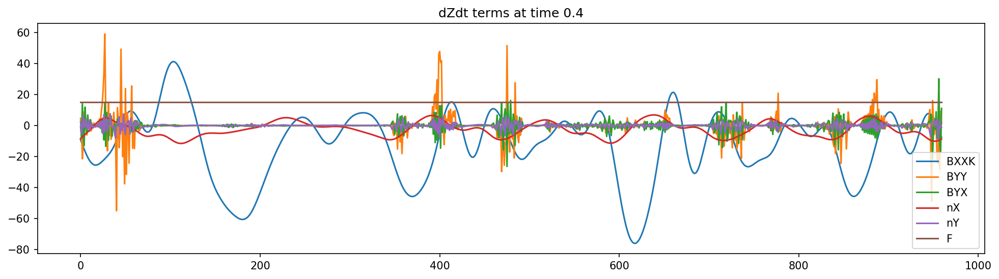

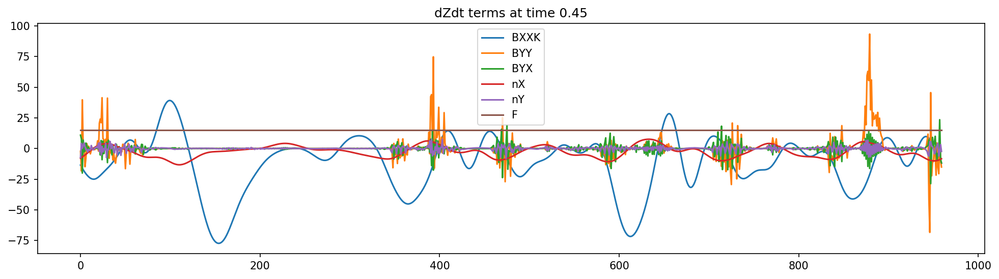

In [321]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(BXXK[:, ii])
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(F * np.ones(N_Z))
    plt.title(f'dZdt terms at time {t[ii]}')
    plt.legend(['BXXK', 'BYY', 'BYX', 'nX', 'nY', 'F'])

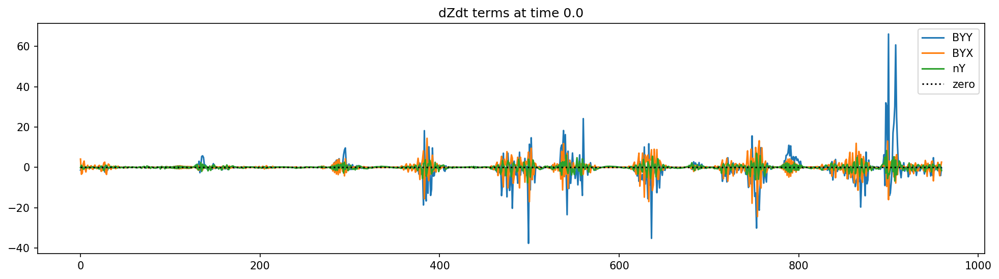

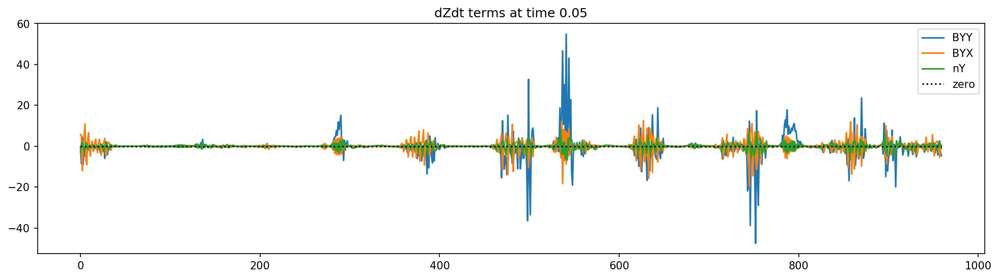

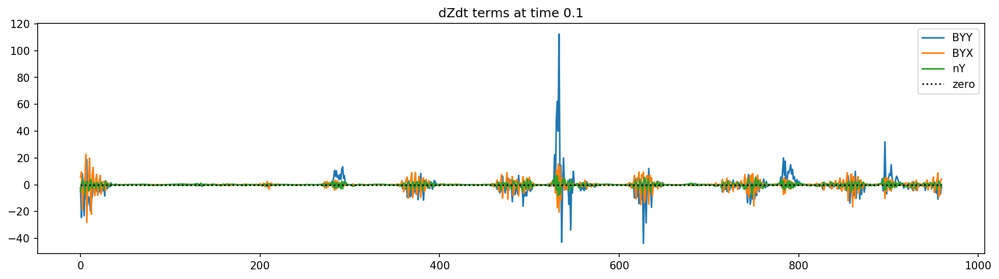

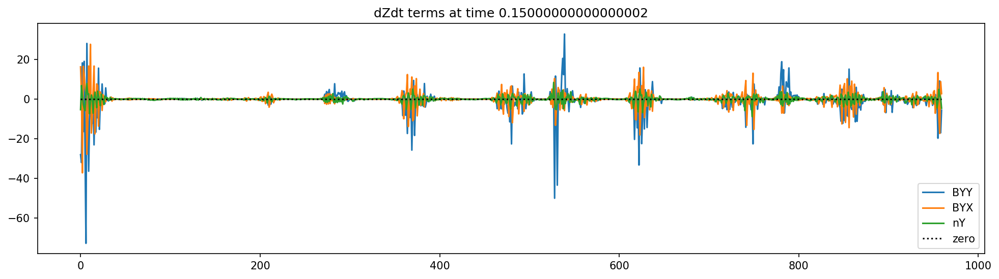

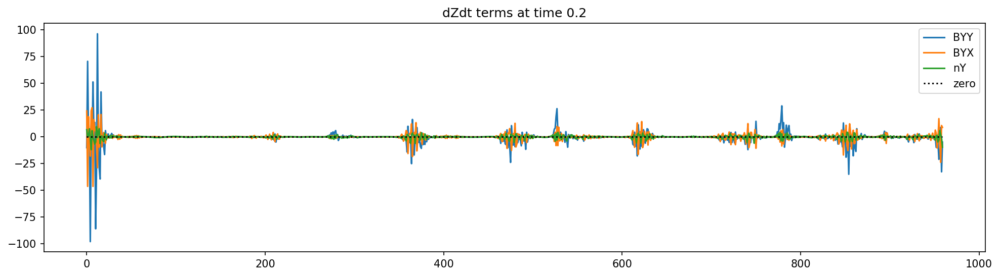

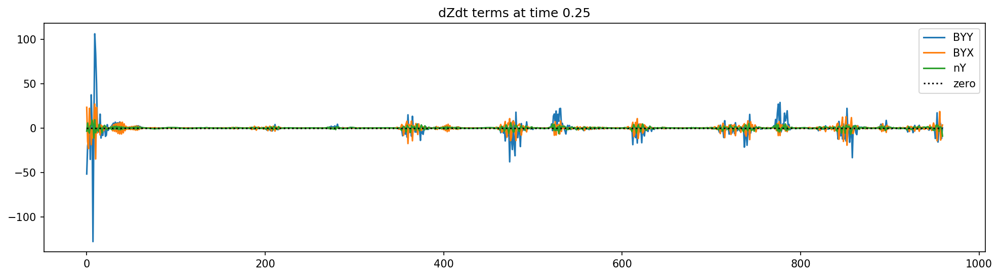

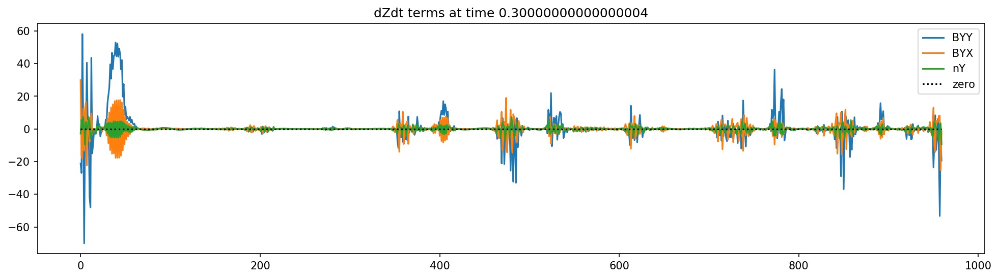

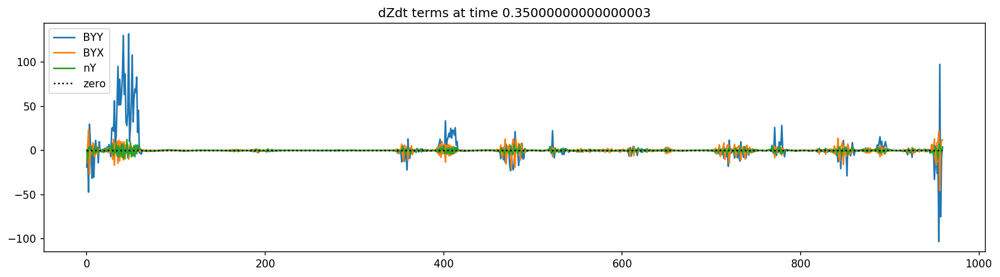

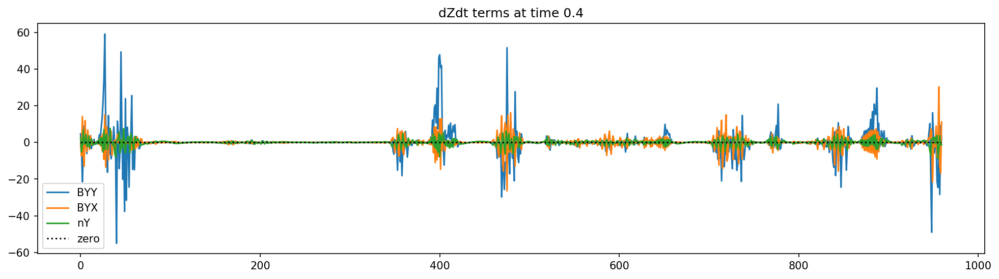

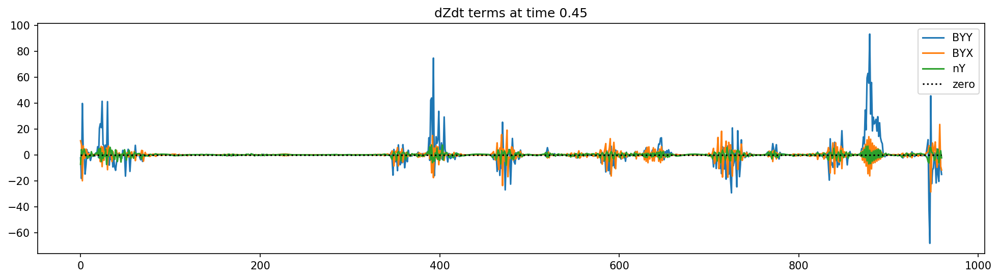

In [322]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(np.zeros(N_Z), 'k:')
    plt.title(f'dZdt terms at time {t[ii]}')
    plt.legend(['BYY', 'BYX', 'nY', 'zero'])

In [323]:
wBYY = window_sum_Z(BYY, I=I, alpha=alpha, beta=beta)
wBYX = window_sum_Z(BYX, I=I, alpha=alpha, beta=beta)
wnY = window_sum_Z(nY, I=I, alpha=alpha, beta=beta)

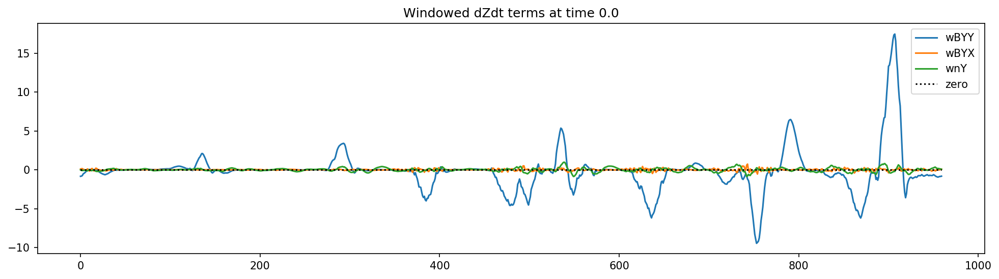

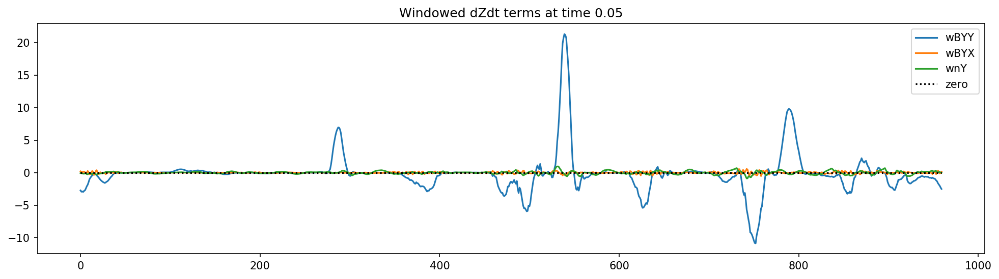

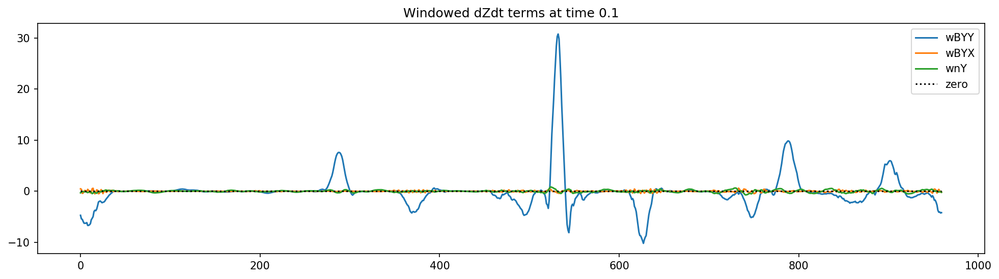

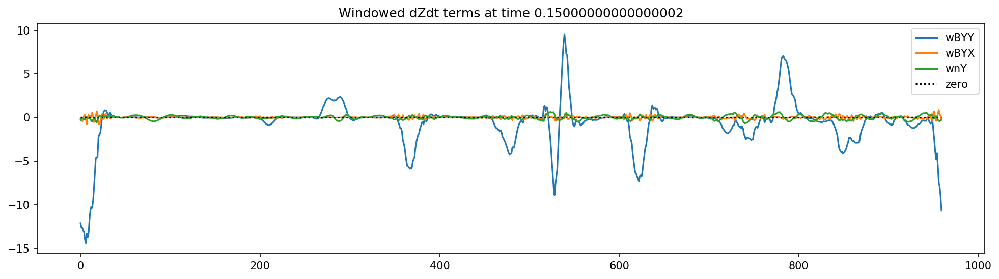

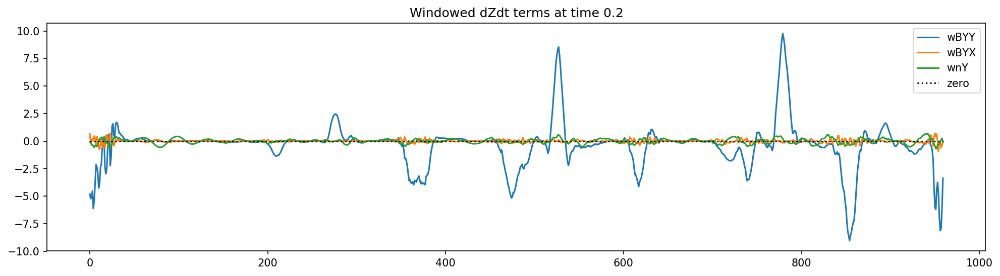

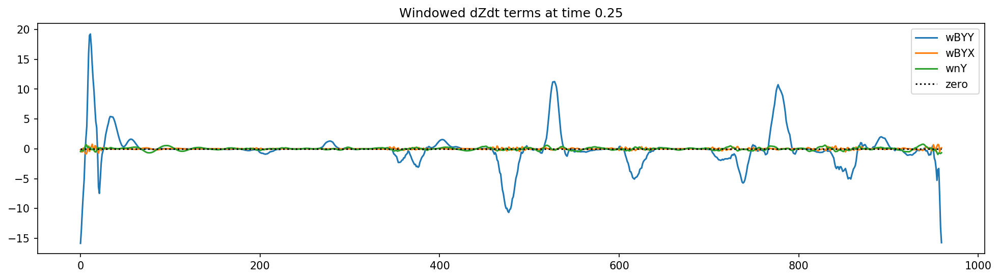

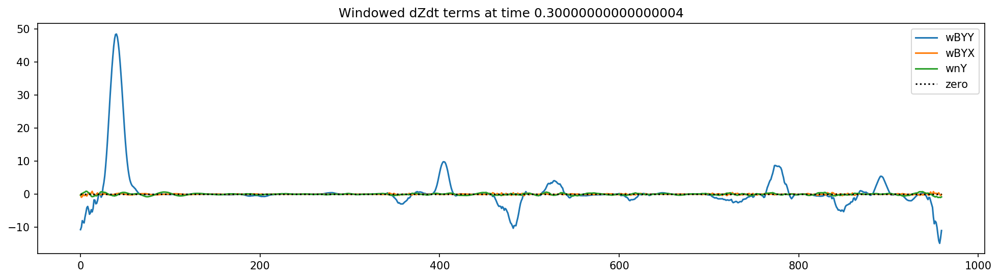

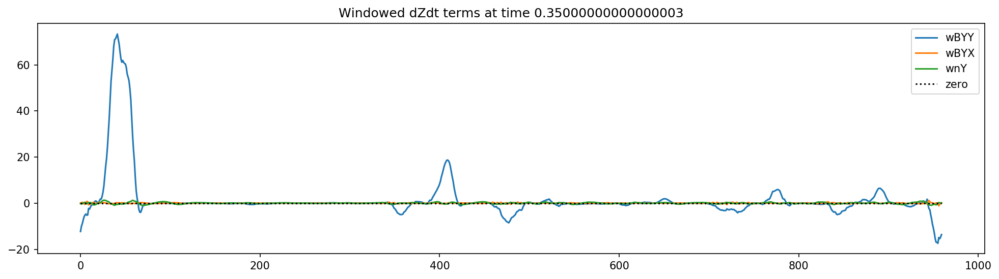

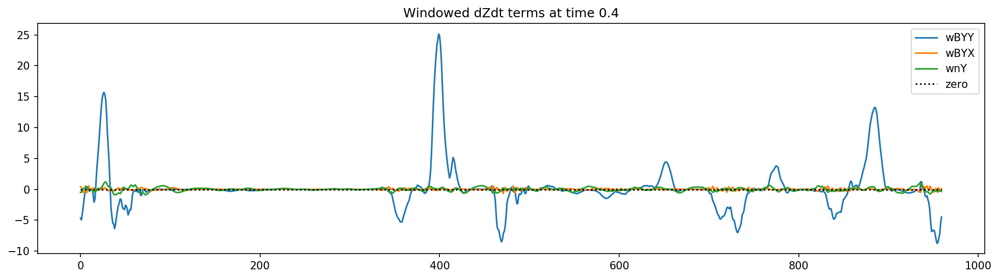

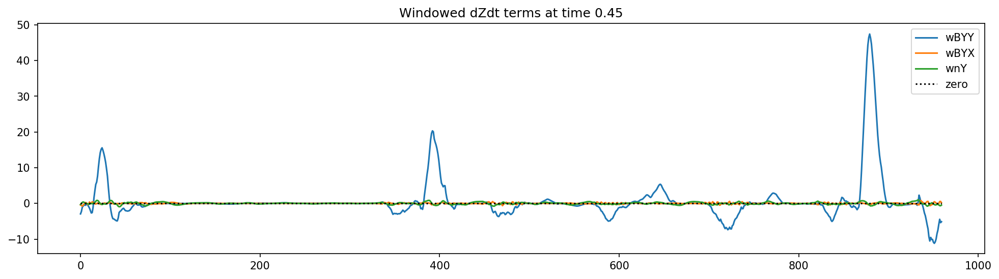

In [324]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(wBYY[:, ii])
    plt.plot(wBYX[:, ii])
    plt.plot(wnY[:, ii])
    plt.plot(np.zeros(N_Z), 'k:')
    plt.title(f'Windowed dZdt terms at time {t[ii]}')
    plt.legend(['wBYY', 'wBYX', 'wnY', 'zero'])

Text(0,0.5,'Windowed BYY')

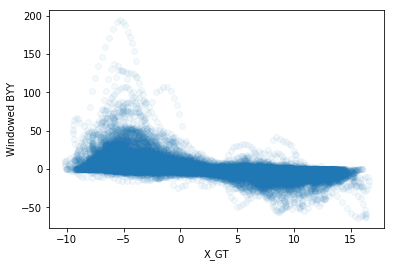

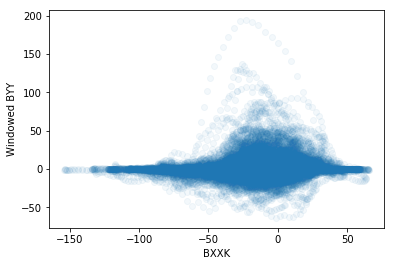

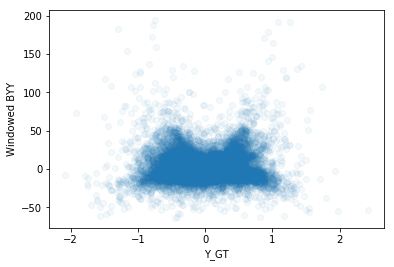

In [325]:
plt.figure()
plt.scatter(X_GT[:, ::100], wBYY[:, ::100], alpha=.05)
plt.xlabel('X_GT')
plt.ylabel('Windowed BYY')

plt.figure()
plt.scatter(BXXK[:, ::100], wBYY[:, ::100], alpha=.05)
plt.xlabel('BXXK')
plt.ylabel('Windowed BYY')

plt.figure()
plt.scatter(Y_GT[:, ::100], wBYY[:, ::100], alpha=.05)
plt.xlabel('Y_GT')
plt.ylabel('Windowed BYY')

Text(0,0.5,'BYY')

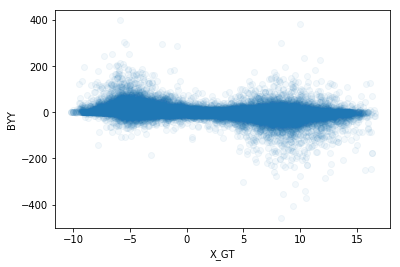

In [326]:
plt.figure()
plt.scatter(X_GT[:, ::100], BYY[:, ::100], alpha=.05)
plt.xlabel('X_GT')
plt.ylabel('BYY')